# Self-Driving Car Engineer Nanodegree


## Project: **Finding Lane Lines on the Road** 

Built by Dmitry Zaganich in September 2017
***
The goals / steps of this project are the following:

1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
2. Apply a distortion correction to raw images.
3. Use color transforms, gradients, etc., to create a thresholded binary image.
4. Apply a perspective transform to rectify binary image ("birds-eye view").
5. Detect lane pixels and fit to find the lane boundary.
6. Warp the detected lane boundaries back onto the original image.
7. Determine the curvature of the lane, estimate vehicle position with respect to center and apply smoothing effect.
8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.
***

## Step 0. Imports, utils and settings

In [1]:
# project dependencies

import os
import math
import cv2
import glob
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib as matplotlib
from moviepy.editor import VideoFileClip
from IPython.display import display, HTML
%matplotlib inline

In [2]:
# logging functions

def show_images_comparsion_table(images_original, images_changed, title_1=None, title_2=None):
    idx = 1
    rows = len(images_original)
    
    for original, changed in zip(images_original, images_changed):    
        plt.subplot(rows, 2, idx);
        plt.imshow(original);
        if title_1: 
            plt.title(title_1)
        plt.axis('off')    
        
        plt.subplot(rows, 2, idx+1);
        plt.imshow(changed);
        if title_2: 
            plt.title(title_2)
        plt.axis('off')
            
        idx = idx + 2
        
def show_images_comparsion_row(images, titles):
    idx = 1
    columns = len(images)
    for image, title in zip(images, titles):    
        plt.subplot(1, columns, idx);
        plt.imshow(image);
        plt.title(title)
        plt.axis('off')    
        
        idx = idx + 1
        
def show_images_comparsion_row_gray(images, titles):
    idx = 1
    columns = len(images)
    for image, title in zip(images, titles):    
        plt.subplot(1, columns, idx);
        plt.imshow(image, cmap='gray');
        plt.title(title)
        plt.axis('off')    
        
        idx = idx + 1        

In [3]:
default_test_image = './test_images/test5.jpg'
default_challenge_image = './challenge_test_images/test5.jpg'
default_hard_image = './hard_challenge_test_images/test2.jpg'

images_paths = glob.glob('./camera_cal/calibration*.jpg')

test_images_paths = glob.glob('./test_images/test*.jpg')

challenge_test_images_paths = glob.glob('./challenge_test_images/test*.jpg')

hard_test_images_paths = glob.glob('./hard_challenge_test_images/test*.jpg')

overlay_text_color = (0, 143, 179)
overlay_lane_color = (0, 143, 179)
overlay_lane_line_color = [0, 0, 254]

While testing my pipeline on the test videos I observed that different perspective transformations and thresholds are needed to successfully identify lane in the different videos. 
These parametres should be chosen with respect of the task of removing car hood from the image and warping images in such a way so my pipeline might identify the longest portion of the lane. For example, in "hard" test video I had to use smaller trapezoid of source points than in regular test video, because otherwise the pipeline captures lane-like pixels from the corners of the road.
After playing with these parametres and researching how they were chosen by others I used parametres from the repo https://github.com/awbrown90/Advance-Lane-Finding.

In [4]:
gradx_thresh = 0 # gradient x threshold
grady_thresh = 0 # gradient y threshold
schannel_thresh = 0 # gradient s channel threshold
vchannel_thresh = 0 # gradient v channel threshold

bot_width = 0 # percent of bottom trapizoid height
mid_width = 0 # percent of middle trapizoid height
height_pct = 0 # percent for trapizoid height
bottom_trim = 0 # percent from top to bottom to avoid car hood

In [5]:
def enable_default_options():
    global gradx_thresh 
    global grady_thresh 
    global schannel_thresh 
    global vchannel_thresh 
    global bot_width 
    global mid_width 
    global height_pct 
    global bottom_trim 
    
    gradx_thresh = (25,255) 
    grady_thresh = (10,255) 
    schannel_thresh = (100,255) 
    vchannel_thresh = (200,255) 

    bot_width = .76 
    mid_width = .1 
    height_pct = .63 
    bottom_trim = .935 
    
def enable_challenge_options():
    global gradx_thresh 
    global grady_thresh 
    global schannel_thresh 
    global vchannel_thresh 
    global bot_width 
    global mid_width 
    global height_pct 
    global bottom_trim
    
    gradx_thresh = (20,255) 
    grady_thresh = (20,255) 
    schannel_thresh = (8,255) 
    vchannel_thresh = (160,255) 

    bot_width = .76 
    mid_width = .25 
    height_pct = .7 
    bottom_trim = .935 
    
def enable_challenge_options_backup():
    global gradx_thresh 
    global grady_thresh 
    global schannel_thresh 
    global vchannel_thresh 
    global bot_width 
    global mid_width 
    global height_pct 
    global bottom_trim
    
    gradx_thresh = (20,255) 
    grady_thresh = (20,255) 
    schannel_thresh = (8,255) 
    vchannel_thresh = (160,255) 

    bot_width = .76 
    mid_width = .25 
    height_pct = .7 
    bottom_trim = .935 

def enable_hard_challenge_options():  
    global gradx_thresh 
    global grady_thresh 
    global schannel_thresh 
    global vchannel_thresh 
    global bot_width 
    global mid_width 
    global height_pct 
    global bottom_trim
    
    gradx_thresh = (20,255) 
    grady_thresh = (20,255) 
    schannel_thresh = (240,255)
    vchannel_thresh = (240,255)

    bot_width = .76 
    mid_width = .3
    height_pct = .73
    bottom_trim = .935

In [6]:
enable_default_options()

### Step 1. Camera calibration

First of all, to successfully identify a lane on a road I need a way to undistort any image, provided by given camera. In order to do so, I calculate the camera calibration matrix and distortion coefficients by utilizing a set of chessboard images.   

In [7]:
# calibrate the camera

board_shape = (9, 6)  # Corners we expect to be detected on the chessboard

all_obj_points = []  # 3D points in real-world space
all_img_points = []  # 2D points in the image

images_original = []
images_changed = []

for image_path in images_paths:
    print("process image ", image_path)
    
    image = mpimg.imread(image_path)

    obj_points = np.zeros((board_shape[0]*board_shape[1], 3), np.float32)
        
    obj_points[:,:2] = np.mgrid[0:board_shape[0], 0:board_shape[1]].T.reshape(-1, 2)  # x, y coordinates

    # convert image to the grayscale
    image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # find the chessboard corners
    ret, corners = cv2.findChessboardCorners(image_gray, board_shape, None)
    
    if ret:
        all_obj_points.append(obj_points)
        all_img_points.append(corners)
        
        image_original = image.copy()
        
        image_overlay = cv2.drawChessboardCorners(image, board_shape, corners, ret)
        
        images_original.append(image_original)
        images_changed.append(image_overlay)
    else:
        print("Could not find chessboard corners in:", image_path)
    
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(all_obj_points, all_img_points, image_gray.shape, None, None)

process image  ./camera_cal\calibration1.jpg
Could not find chessboard corners in: ./camera_cal\calibration1.jpg
process image  ./camera_cal\calibration10.jpg
process image  ./camera_cal\calibration11.jpg
process image  ./camera_cal\calibration12.jpg
process image  ./camera_cal\calibration13.jpg
process image  ./camera_cal\calibration14.jpg
process image  ./camera_cal\calibration15.jpg
process image  ./camera_cal\calibration16.jpg
process image  ./camera_cal\calibration17.jpg
process image  ./camera_cal\calibration18.jpg
process image  ./camera_cal\calibration19.jpg
process image  ./camera_cal\calibration2.jpg
process image  ./camera_cal\calibration20.jpg
process image  ./camera_cal\calibration3.jpg
process image  ./camera_cal\calibration4.jpg
Could not find chessboard corners in: ./camera_cal\calibration4.jpg
process image  ./camera_cal\calibration5.jpg
Could not find chessboard corners in: ./camera_cal\calibration5.jpg
process image  ./camera_cal\calibration6.jpg
process image  ./cam

In [8]:
# print camera data

print("ret ", ret)
print("mtx ", mtx)
print("dist ", dist)
print("rvecs ", rvecs)
print("tvecs ", tvecs)

print("original images ", len(images_original))

ret  1.1868974045381142
mtx  [[  1.15396100e+03   0.00000000e+00   6.69706492e+02]
 [  0.00000000e+00   1.14802503e+03   3.85655582e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
dist  [[ -2.41018767e-01  -5.30665431e-02  -1.15811319e-03  -1.28284935e-04
    2.67026162e-02]]
rvecs  [array([[ 0.5071649 ],
       [-0.22122311],
       [ 0.02988753]]), array([[ 0.03492344],
       [ 0.45739608],
       [ 0.00492842]]), array([[ 0.03471061],
       [ 0.65086596],
       [ 0.00971056]]), array([[-0.33084444],
       [ 0.6591486 ],
       [-0.41537696]]), array([[ 0.05531809],
       [-0.51892831],
       [-0.00398606]]), array([[-0.02434134],
       [-0.48814901],
       [ 0.02054064]]), array([[ 0.04125064],
       [-0.46371916],
       [-0.05619954]]), array([[ 0.21226714],
       [-0.0671929 ],
       [ 0.01248474]]), array([[ 0.1785025 ],
       [-0.06187108],
       [ 0.00114962]]), array([[ 0.08447403],
       [ 0.3803981 ],
       [ 0.05427278]]), array([[ 0.63236547],
 

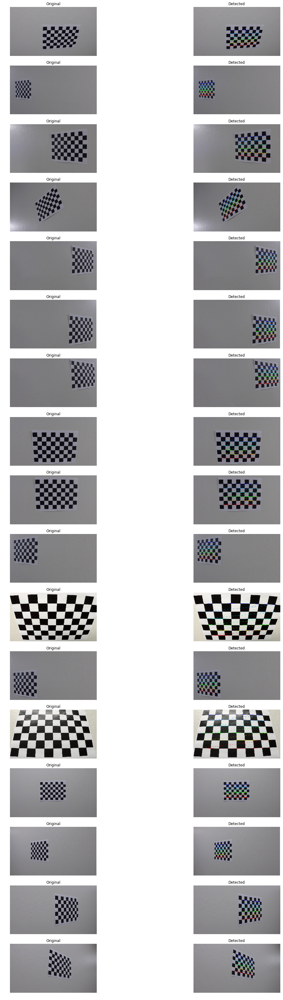

In [9]:
# show detected chessboards corners

matplotlib.rcParams['figure.figsize'] = (20.0, 60.0)

show_images_comparsion_table(images_original, images_changed, "Original", "Detected")

### Step 2. Apply a distortion correction to raw images.

After computing a set of camera params with opencv, I can finally undistort an image. I start with a little sanity check by undistorting one of the calibration images. Then I undistort an example image and compare it with the original version. 

In [10]:
def undistort(image):
    return cv2.undistort(image, mtx, dist, None, mtx)

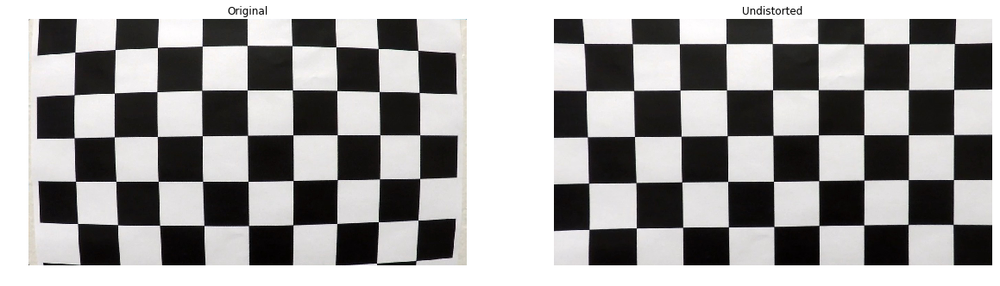

In [11]:
# show undistorted chessboard image

image_test = mpimg.imread('./camera_cal/calibration1.jpg')
image_undistorted = undistort(image_test)

show_images_comparsion_row([image_test, image_undistorted], ["Original", "Undistorted"])

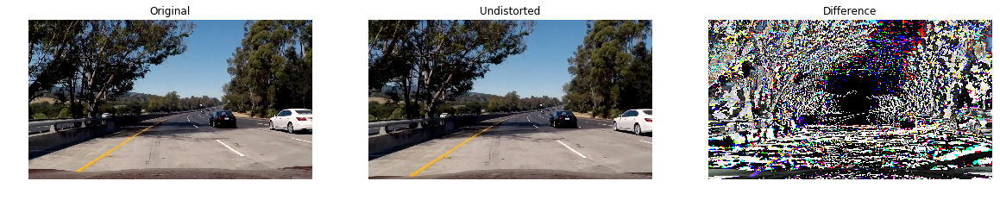

In [12]:
# show undistorted test image

image_test = mpimg.imread(default_test_image)
image_undistorted = undistort(image_test)

image_diff = image_undistorted - image_test

show_images_comparsion_row([image_test, image_undistorted, image_diff], ["Original", "Undistorted", "Difference"])

### Step 3. Thresholding

To successfully extract the lane from an image I need to threshold the image in such a way so lane lines will be clearly visible on the output image. I decided to combine pixels from the original image, which was transformed to the different color spaces to the pixels from an image generated by applying sobel operator to the original image in different directions.

In [13]:
# util functions for step 3

def display_color_space(image, color_space, title):
    image_conv = cv2.cvtColor(image, color_space)
    
    plt.figure()
    
    plt.subplot(1, 4, 1)
    plt.imshow(image)
    plt.axis('off')
    
    for i in range(3):
        plt.subplot(1, 4, i + 2)
        image_i = image_conv[:, :, i]
        plt.imshow(255*(image_i/np.max(image_i)), cmap='gray')
        plt.axis('off')
    plt.title(title)

def to_rgb_image(image):
    return 255 * np.dstack((image, image, image))
    
def apply_mask(image, threshold):
    binary_output = np.zeros_like(image)
    binary_output[(image >= threshold[0]) & (image <= threshold[1])] = 1
    return binary_output
    
def apply_sobel_mask_direction(image, sobel_kernel=3, direction='x', threshold=(0, 255)):
    # Get sobel in direction
    
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Take the derivative in x or y given orient = 'x' or 'y'
    if direction == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif direction == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        
    # Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    
    # Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # Create a mask of 1's where the scaled gradient magnitude 
    # is > thresh_min and < thresh_max
    return apply_mask(scaled_sobel, threshold)

# apply color selection
def color_threshold(image, sthresh=(0,255), vthresh=(0,255)):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= sthresh[0]) & (s_channel <= sthresh[1])  ] = 1

    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    v_binary = np.zeros_like(v_channel)
    v_binary[(v_channel >= vthresh[0]) & (v_channel <= vthresh[1])  ] = 1
    
    output = np.zeros_like(s_channel)
    output[(s_binary == 1) & (v_binary == 1)] = 1
    return output

def get_thresholded_image(image):
    global gradx_thresh
    global grady_thresh
    global schannel_thresh
    global vchannel_thresh
    
    # process image and generate binary pixel of interests
    out_image = np.zeros_like(image[:,:,0])
    
    gradx = apply_sobel_mask_direction(image, direction='x', threshold=gradx_thresh) 
    grady = apply_sobel_mask_direction(image, direction='y', threshold=grady_thresh) 
    
    color_mask = color_threshold(image, sthresh=schannel_thresh, vthresh=vchannel_thresh)
    
    out_image = cv2.bitwise_and(gradx, grady)
    out_image = cv2.bitwise_or(out_image, color_mask)
    
    out_image = to_rgb_image(out_image)
    
    return out_image

#### Step 3.1 Compare color spaces

I start with transformation of test images to the different color spaces. Let's investigate the results!

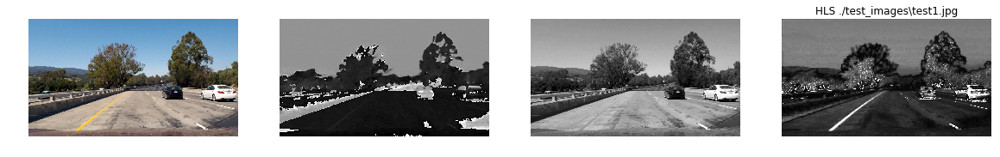

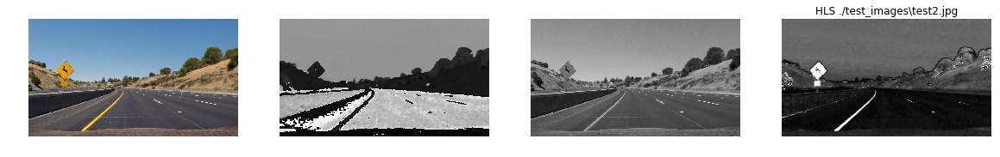

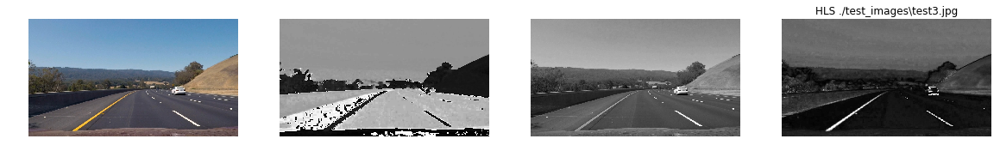

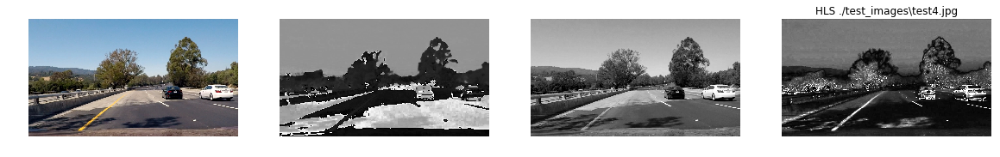

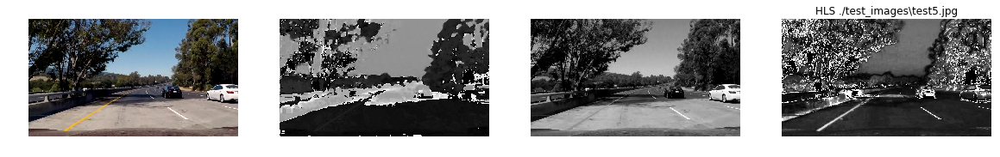

...

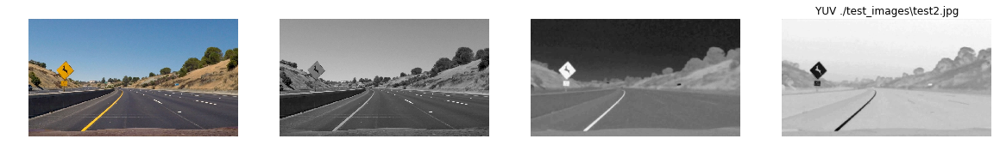

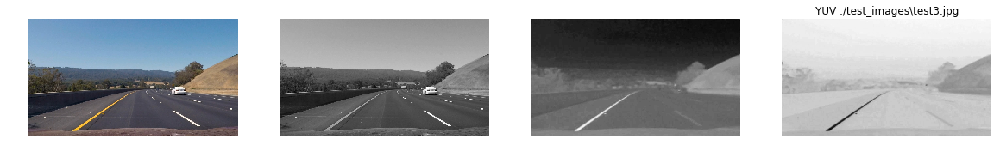

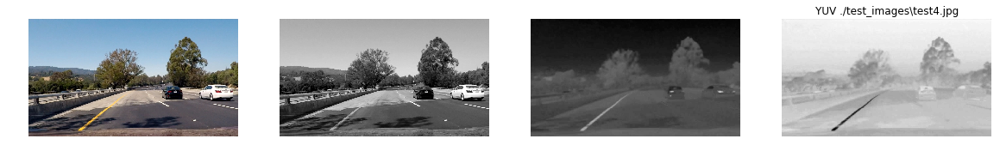

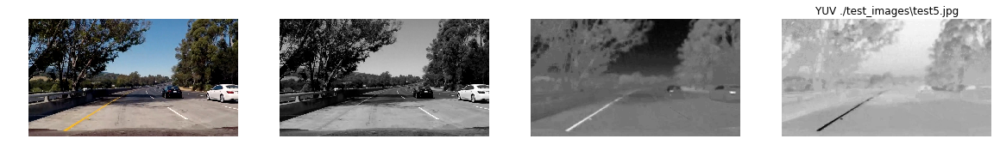

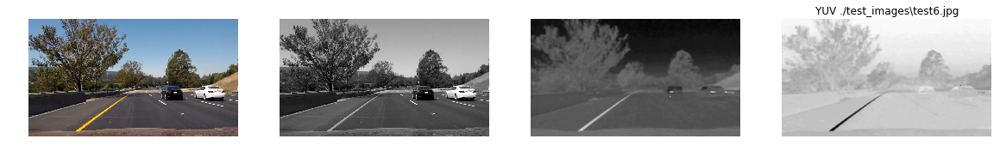

In [14]:
# show HLS color space

for image_path in test_images_paths:
    image = mpimg.imread(image_path)
    display_color_space(image, cv2.COLOR_RGB2HLS, "HLS "+image_path)
    
# show HSV color space

for image_path in test_images_paths:
    image = mpimg.imread(image_path)
    display_color_space(image, cv2.COLOR_RGB2HSV, "HSV "+image_path)
    
# show YUV color space

for image_path in test_images_paths:
    image = mpimg.imread(image_path)
    display_color_space(image, cv2.COLOR_RGB2YUV, "YUV "+image_path)

It appears that the lane lines have the hishest visibility in V channel of HSV color space and in S channel of HLS. By combining them together we can get a pretty robust lane detection. But we should reinforce it with additional filter by using the sobel operator.

#### Step 3.2 Apply sobel operator and combine all filters together into thresholded image

V, S channels and gradients were combined separately by applying "bitwise_and" and then I pierced them together with "bitwise_or" to the final threshold image. It resulted in a robust way of highlighting lane lines in the image.
The results of applying sobel operator and an example of final thresholded image are show below. 

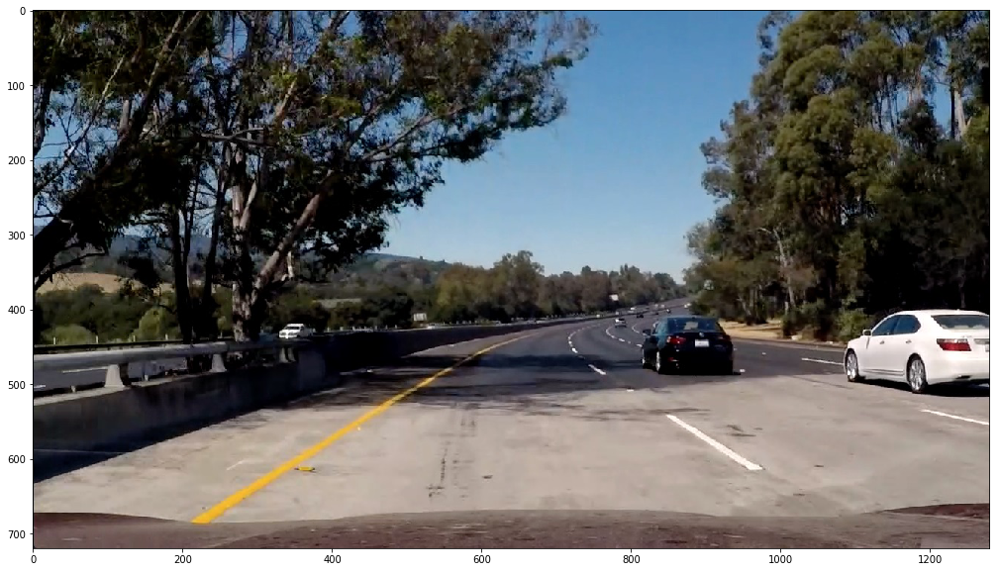

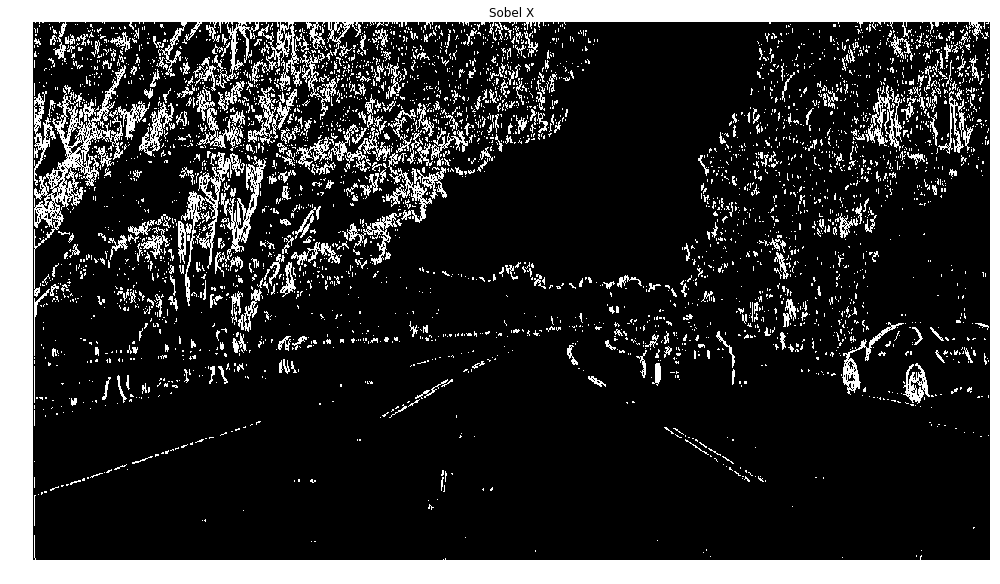

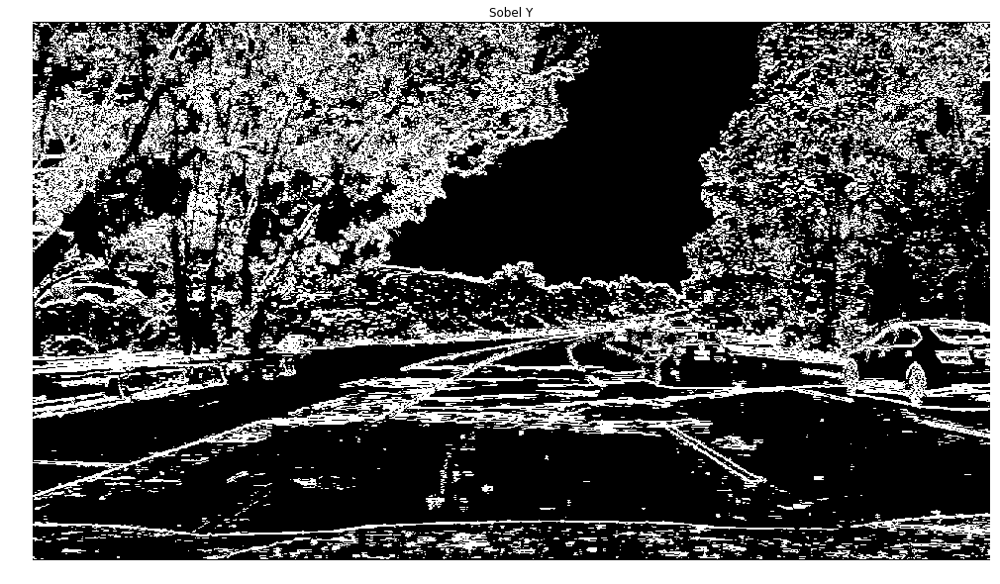

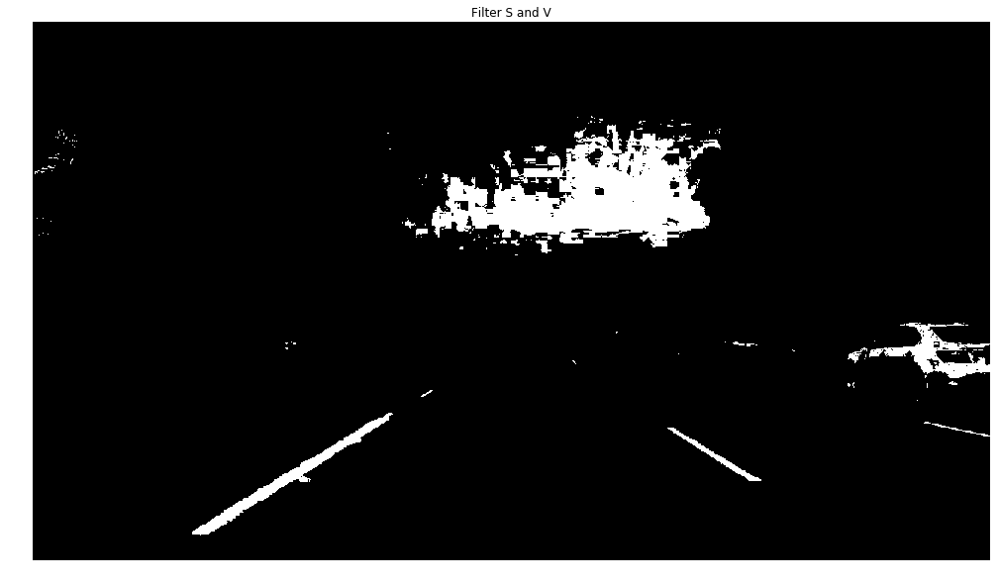

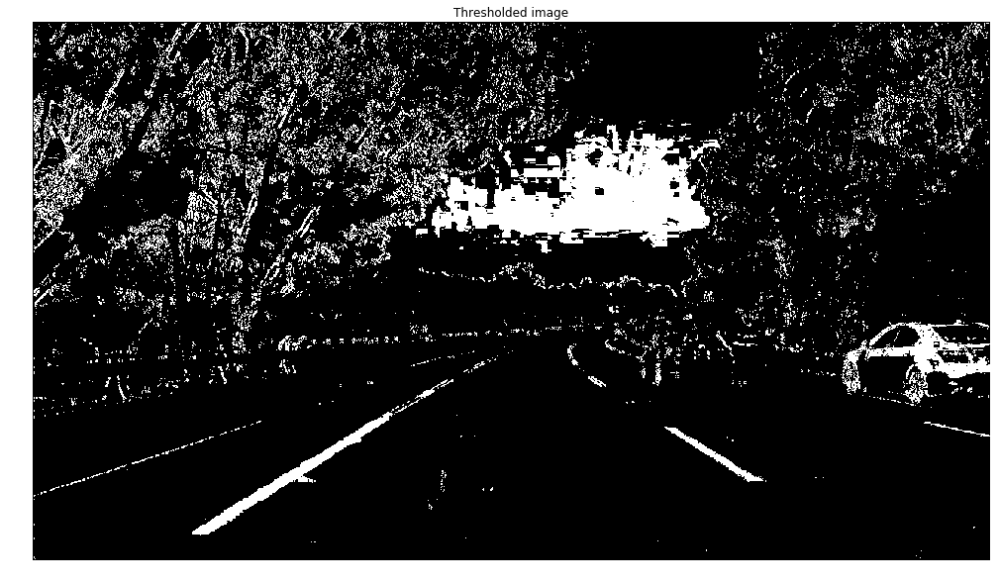

In [15]:
# show sobel and magnitude transformations
matplotlib.rcParams['figure.figsize'] = (20.0, 10.0)

image = mpimg.imread(default_test_image)

gradx = apply_sobel_mask_direction(image, direction='x', threshold=gradx_thresh) 
grady = apply_sobel_mask_direction(image, direction='y', threshold=grady_thresh) 
    
color_mask = color_threshold(image, sthresh=schannel_thresh, vthresh=vchannel_thresh)

thresholded = get_thresholded_image(image)

plt.figure();
plt.imshow(image);

plt.figure();
plt.imshow(gradx, cmap='gray');
plt.axis('off');
plt.title('Sobel X');

plt.figure();
plt.imshow(grady, cmap='gray');
plt.axis('off');
plt.title('Sobel Y');

plt.figure();
plt.imshow(color_mask, cmap='gray');
plt.axis('off');
plt.title('Filter S and V');

plt.figure()
plt.imshow(thresholded, cmap='gray');
plt.axis('off');
plt.title('Thresholded image');

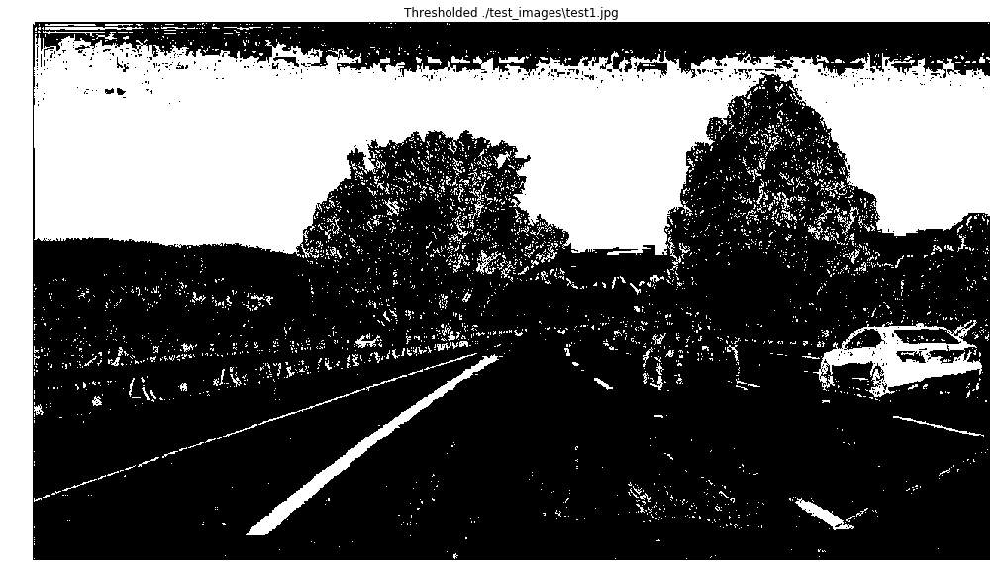

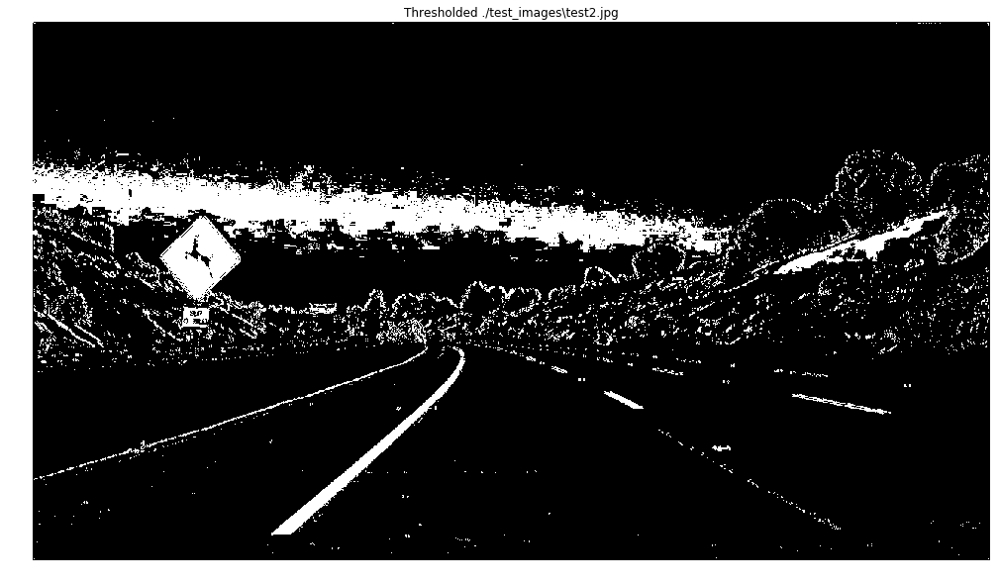

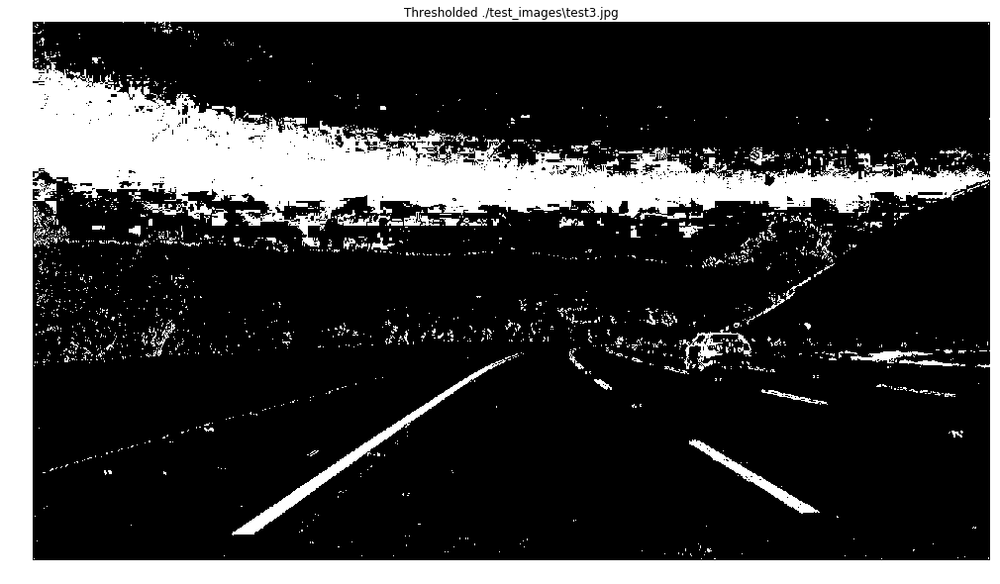

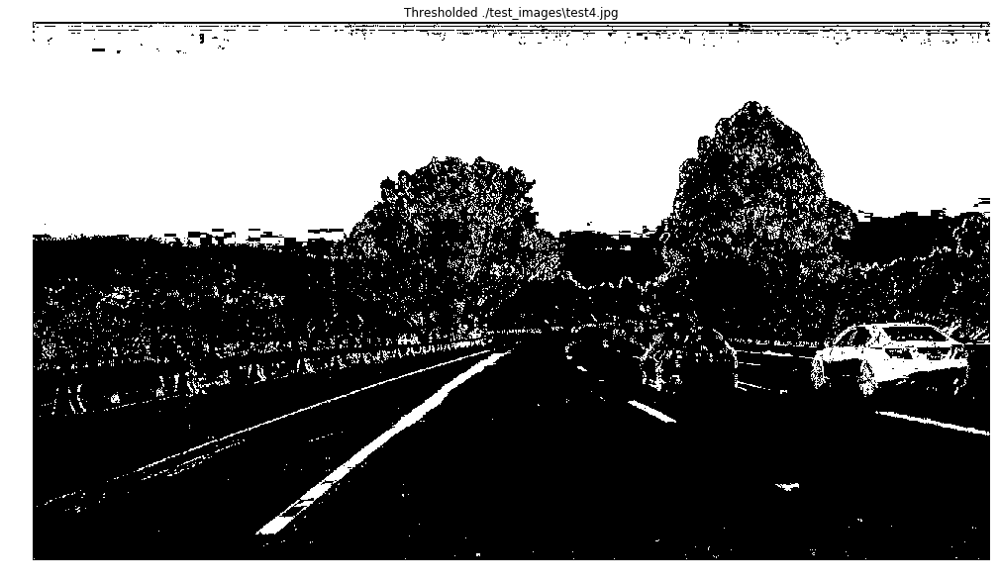

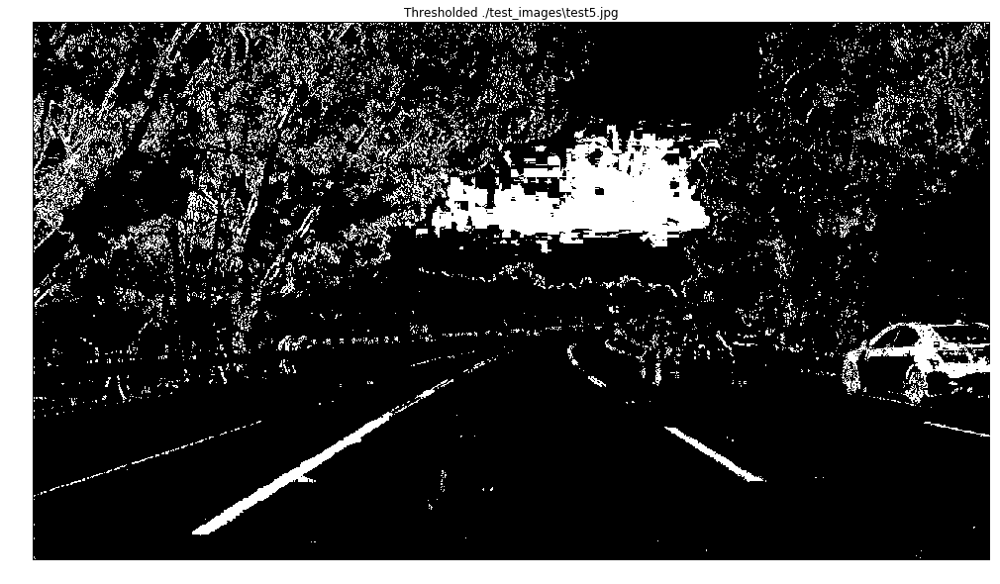

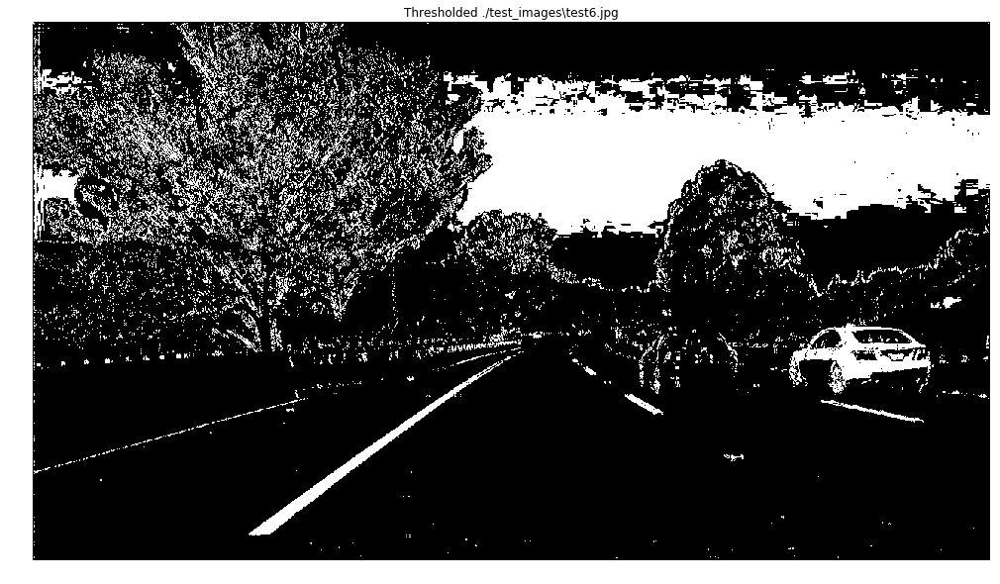

In [16]:
# show thresholded test images

for image_path in test_images_paths:
    image = mpimg.imread(image_path)
    
    plt.figure()
    plt.imshow(get_thresholded_image(image), cmap='gray');
    plt.axis('off');
    plt.title("Thresholded "+ image_path);

### Step 4. Perspective transform

Thresholded image indeed capture lane lines but it captures a lot of other information in the image too, like other lanes, cars, trees and even parts of the sky. 
To focus in on the road portion of the image let's shift our perspective to a top-down view of the road in front of the car by applying perspective transform.

In [17]:
def apply_pespective_transform(image):
    global bot_width # percent of bottom trapizoid height
    global mid_width # percent of middle trapizoid heigh
    global height_pct # percent for trapizoid height
    global bottom_trim # percent from top to bottom to avoid car hood 
    
    # work on defining perspective transformation area
    
    x_shape, y_shape = image.shape[1], image.shape[0]
    
    src = (
        (x_shape*(.5-mid_width/2), y_shape*height_pct),
        (x_shape*(.5+mid_width/2), y_shape*height_pct),
        (x_shape*(.5+bot_width/2), y_shape*bottom_trim),
        (x_shape*(.5-bot_width/2), y_shape*bottom_trim)
    )
    
    offset = x_shape*.33
    
    dst = (
        (offset, 0), 
        (x_shape-offset, 0),
        (x_shape-offset, y_shape), 
        (offset, y_shape)
    )
    
    transform = cv2.getPerspectiveTransform(np.float32(src), np.float32(dst))
    transform_inv = cv2.getPerspectiveTransform(np.float32(dst), np.float32(src))
    warped = cv2.warpPerspective(image, transform, (x_shape, y_shape), flags=cv2.INTER_LINEAR)
    
    return warped, transform, transform_inv, src, dst 

Let's take a look on the trapezoids which are built by applying different sets of parametres.

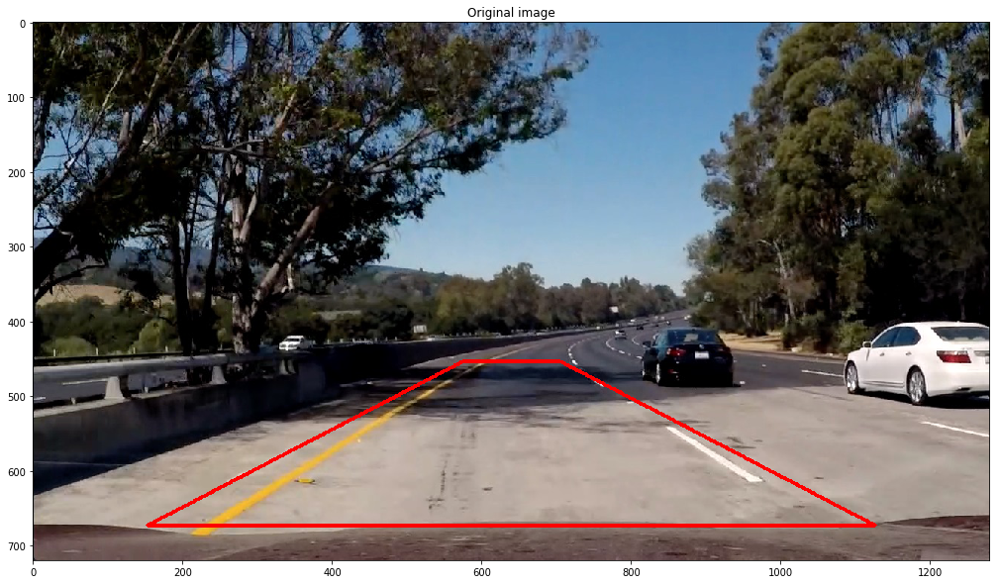

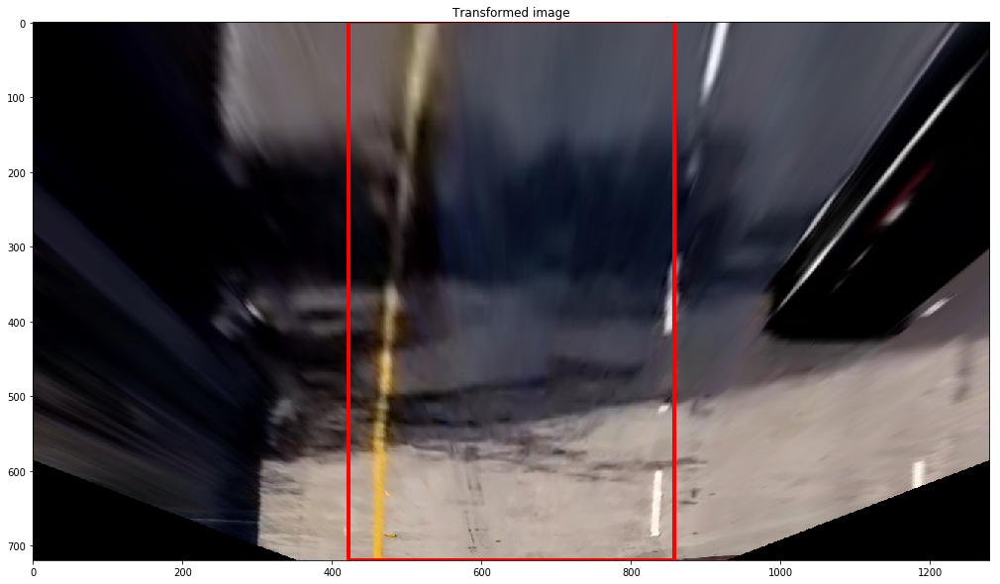

In [18]:
image = mpimg.imread(default_test_image)
image_undistorted = undistort(image)
image_perspective_transformed,_,_, src_pts, dst_pts = apply_pespective_transform(image)

for i in range(4):
    image = cv2.line(image,
                     (int(src_pts[i][0]), int(src_pts[i][1])),
                     (int(src_pts[(i+1)%4][0]), int(src_pts[(i+1)%4][1])),
                     color=[255,0,0],
                     thickness=4)
    
for i in range(4):
    image_perspective_transformed = cv2.line(image_perspective_transformed,
                                             (int(dst_pts[i][0]), int(dst_pts[i][1])),
                                             (int(dst_pts[(i+1)%4][0]), int(dst_pts[(i+1)%4][1])),
                                             color=[255,0,0], 
                                             thickness=4)
    
plt.figure();
plt.imshow(image);
plt.title('Original image');

plt.figure();
plt.imshow(image_perspective_transformed);
plt.title('Transformed image');

The first and the easiest video contains road with mostly straight curve, but the second and especially the third have curved road with smaller horizon. In the second video camera's view blocked by a separator in the middle on the road and the third video contains recording of a small curved road in the forest. To capture information from this videos the pipeline should focus on the smaller portion of the road, the portion which is directly ahead of car. In order to do so, I need to set up smaller trapezoids of source points in transformation function.

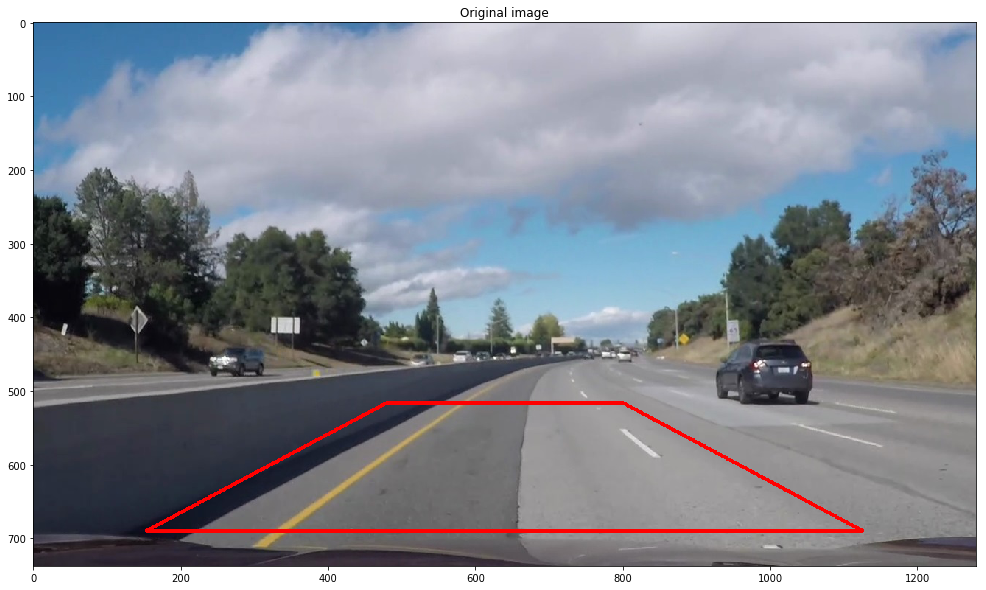

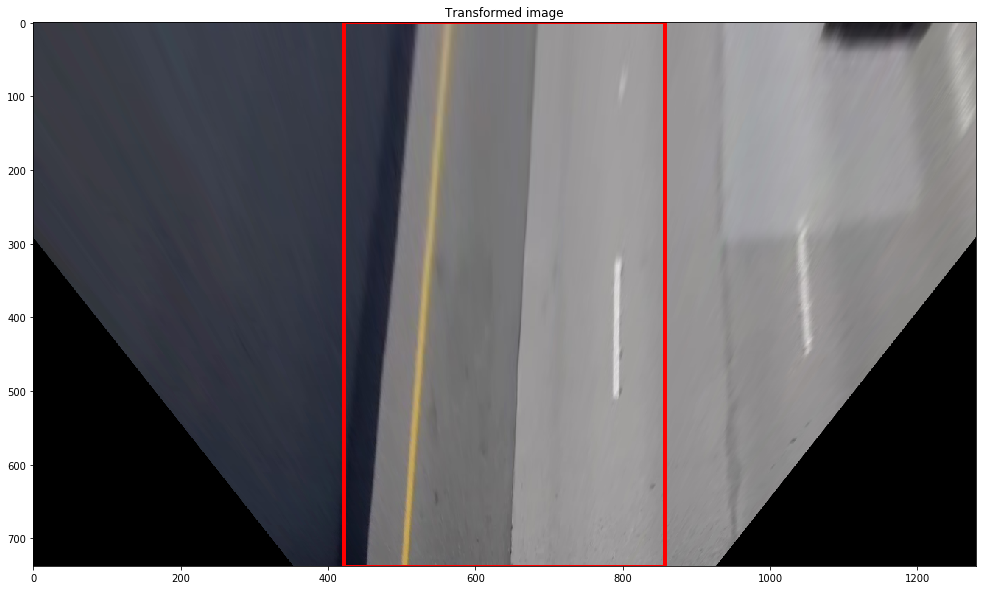

In [19]:
enable_challenge_options()

image = mpimg.imread(default_challenge_image)
image_undistorted = undistort(image)
image_perspective_transformed,_,_, src_pts, dst_pts = apply_pespective_transform(image)

for i in range(4):
    image = cv2.line(image,
                     (int(src_pts[i][0]), int(src_pts[i][1])),
                     (int(src_pts[(i+1)%4][0]), int(src_pts[(i+1)%4][1])),
                     color=[255,0,0],
                     thickness=4)
    
for i in range(4):
    image_perspective_transformed = cv2.line(image_perspective_transformed,
                                             (int(dst_pts[i][0]), int(dst_pts[i][1])),
                                             (int(dst_pts[(i+1)%4][0]), int(dst_pts[(i+1)%4][1])),
                                             color=[255,0,0], 
                                             thickness=4)
    
plt.figure();
plt.imshow(image);
plt.title('Original image');

plt.figure();
plt.imshow(image_perspective_transformed);
plt.title('Transformed image');

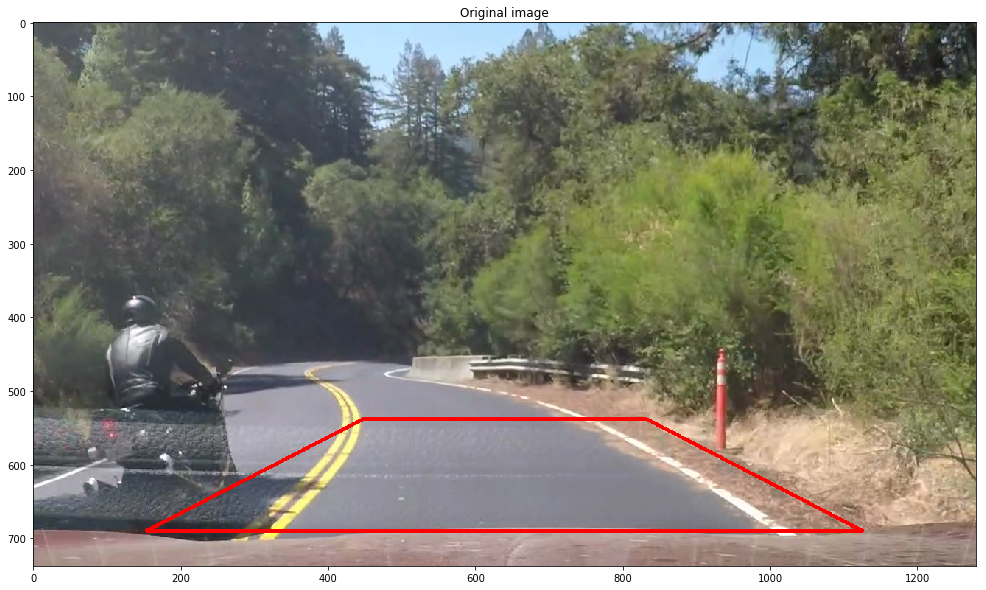

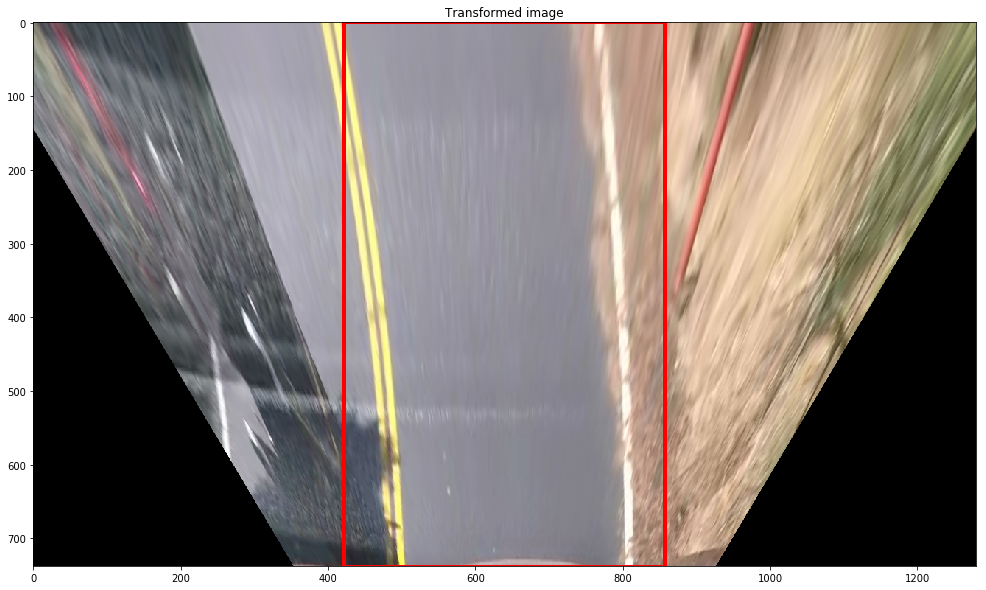

In [20]:
enable_hard_challenge_options()

image = mpimg.imread(default_hard_image)
image_undistorted = undistort(image)
image_perspective_transformed,_,_, src_pts, dst_pts = apply_pespective_transform(image)

for i in range(4):
    image = cv2.line(image,
                     (int(src_pts[i][0]), int(src_pts[i][1])),
                     (int(src_pts[(i+1)%4][0]), int(src_pts[(i+1)%4][1])),
                     color=[255,0,0],
                     thickness=4)
    
for i in range(4):
    image_perspective_transformed = cv2.line(image_perspective_transformed,
                                             (int(dst_pts[i][0]), int(dst_pts[i][1])),
                                             (int(dst_pts[(i+1)%4][0]), int(dst_pts[(i+1)%4][1])),
                                             color=[255,0,0], 
                                             thickness=4)
    
plt.figure();
plt.imshow(image);
plt.title('Original image');

plt.figure();
plt.imshow(image_perspective_transformed);
plt.title('Transformed image');

In [21]:
enable_default_options()

In [22]:
def plot_image_thresholded_warped_comparsion(test_images_path):
    for image_path in test_images_path:
        image = mpimg.imread(image_path)

        image_undistorted = undistort(image)

        image_thresholded = get_thresholded_image(image_undistorted)

        image_perspective_transformed,_,_,_,_ = apply_pespective_transform(image_thresholded)

        plt.figure()

        plt.subplot(1, 3, 1)
        plt.imshow(image)
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(image_thresholded, cmap='gray')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(image_perspective_transformed, cmap='gray')
        plt.axis('off')

        plt.title(image_path)

Now we are ready to take a look on the combination of thresholding and perspective shift.

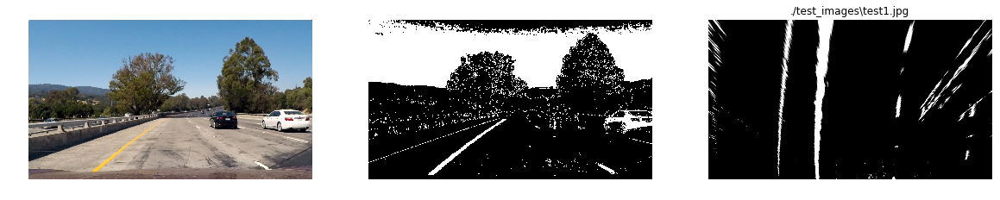

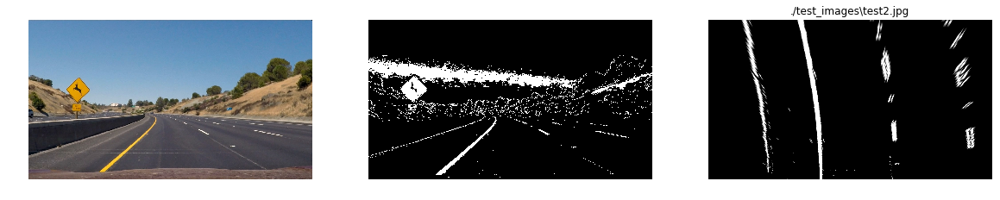

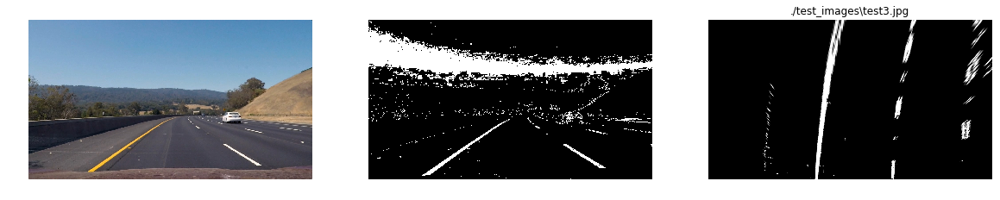

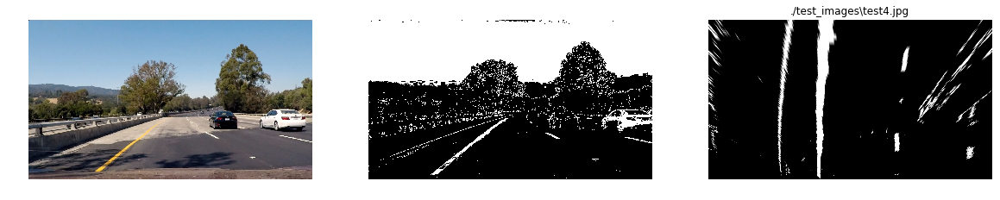

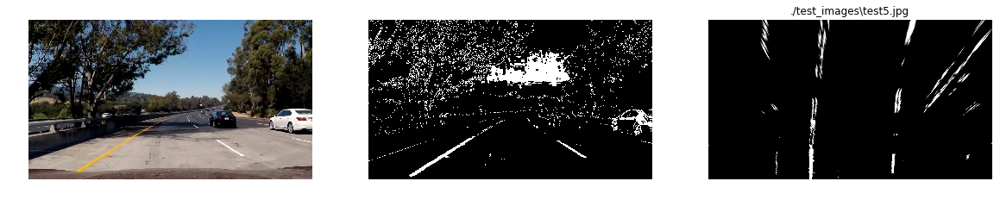

...

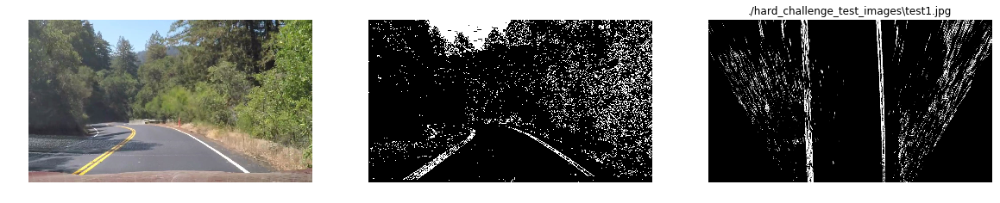

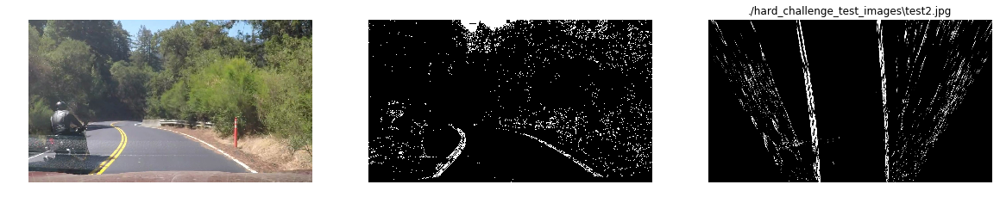

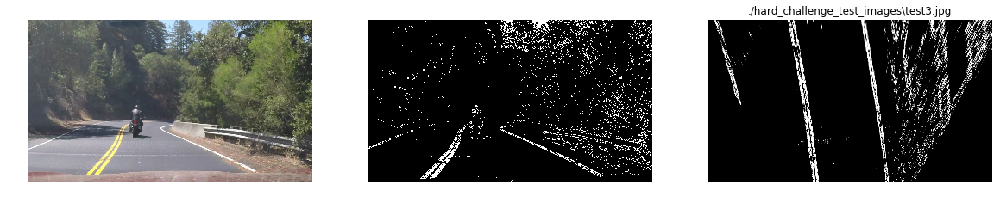

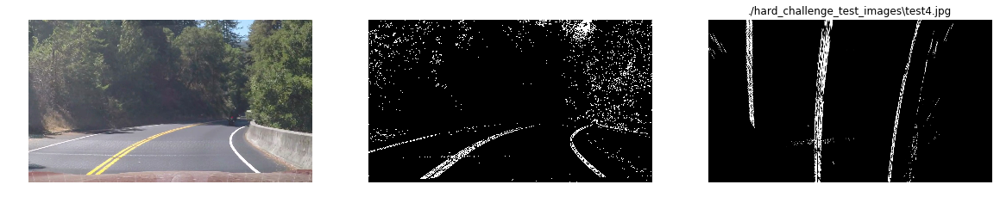

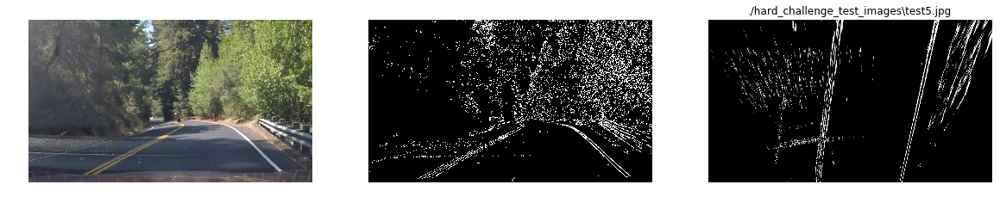

In [23]:
enable_default_options()

plot_image_thresholded_warped_comparsion(test_images_paths)

enable_challenge_options()

plot_image_thresholded_warped_comparsion(challenge_test_images_paths)
    
enable_hard_challenge_options()

plot_image_thresholded_warped_comparsion(hard_test_images_paths)

enable_default_options()    

As we can see, the combination captured lanes in almost all of the test images, except from the image taken below the bridge in "challenge video". 

### Step 5. Detect lane pixels and fit to find the lane boundary.

By applying all of these transformations, I have all the information I need to begin isolating and identifying the lane lines.
To isolate the lane lines I take a histogram at the bottom of the image to identify where the lane lines start. 
Then I use sliding window search and fit two polynomials to find lane lines as suggested in lectures.

In [24]:
def get_histogram(warped_image):
    # Sum the columns in the bottom portion of the image to create a histogram
    histogram = np.sum(warped_image[int(warped_image.shape[0]/2):,:], axis=0)
    return histogram

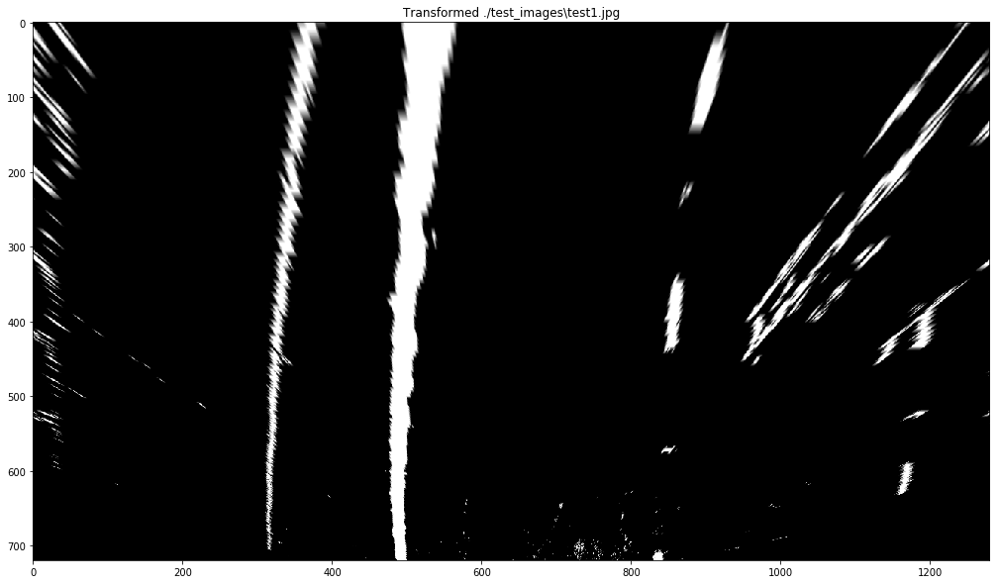

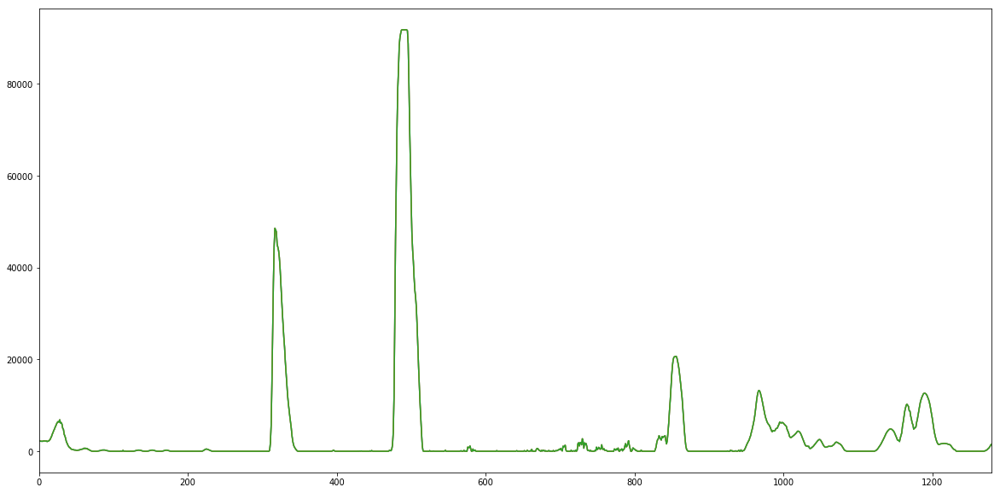

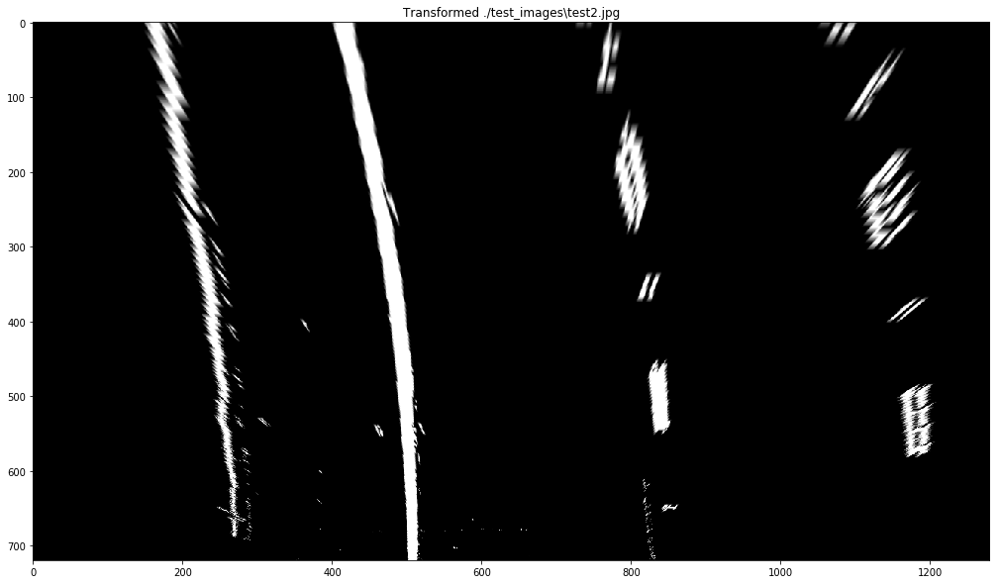

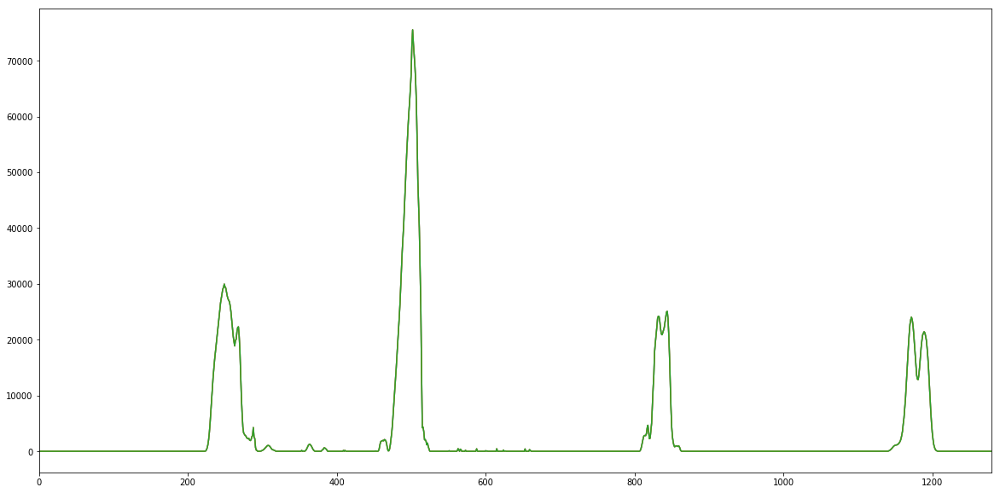

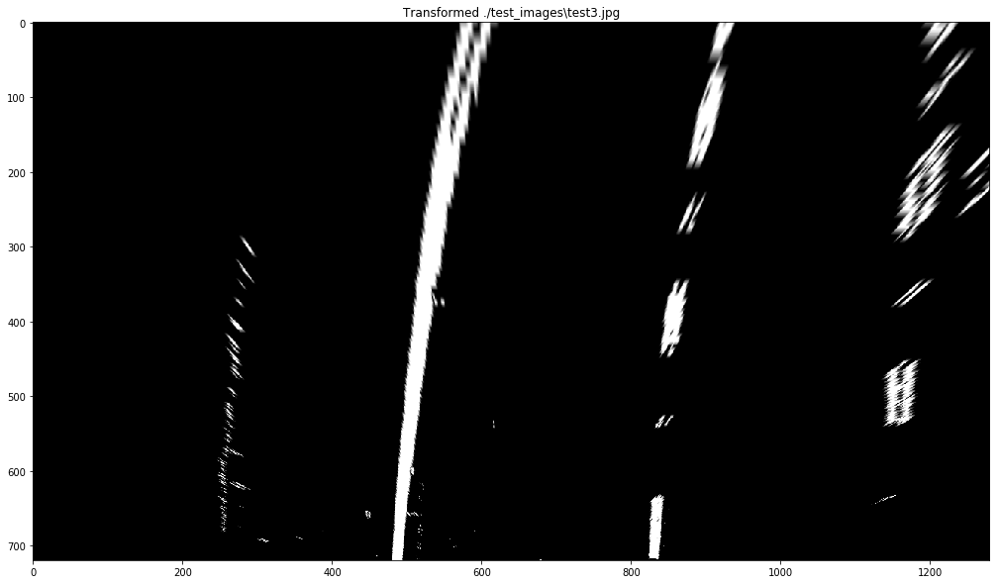

...

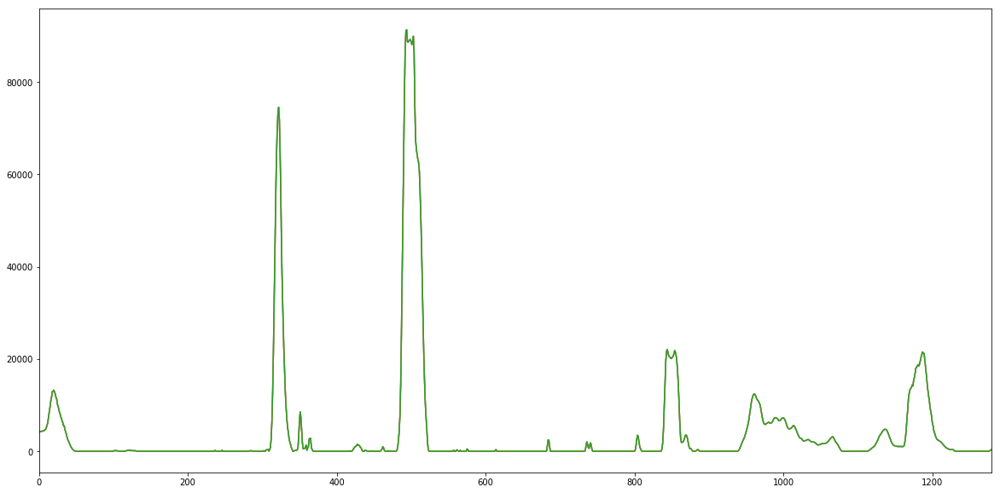

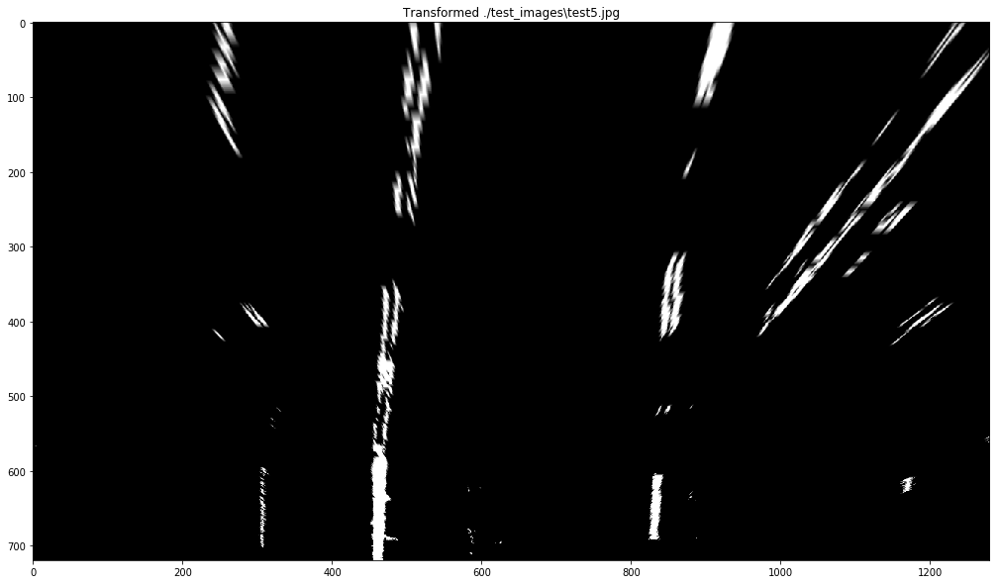

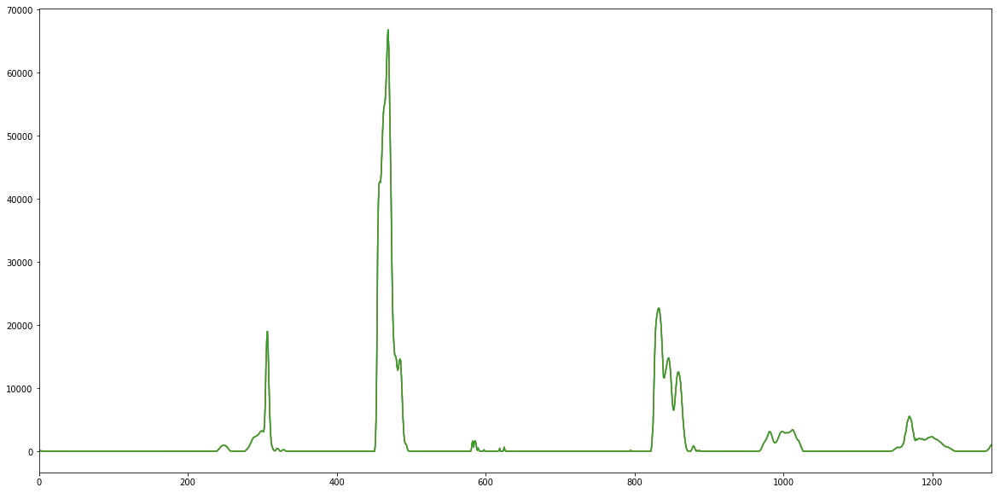

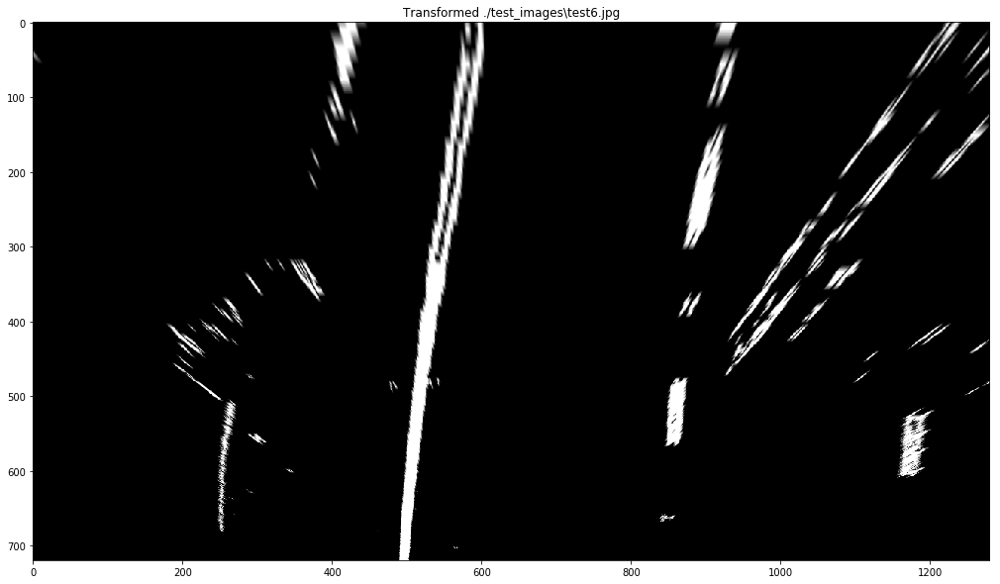

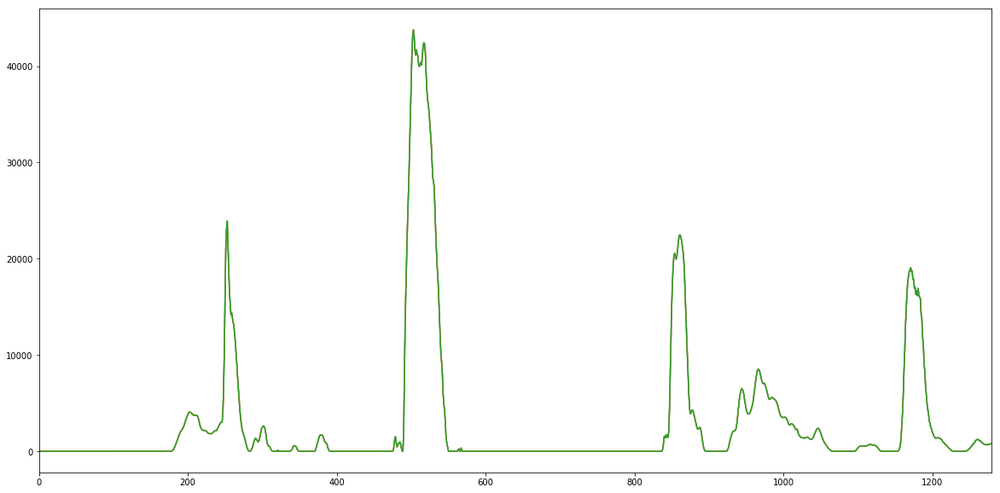

In [25]:
for image_path in test_images_paths:

    image = mpimg.imread(image_path)

    image_undistorted = undistort(image)

    image_thresholded = get_thresholded_image(image_undistorted)

    image_perspective_transformed,_,_,_,_ = apply_pespective_transform(image_thresholded)

    histogram = get_histogram(image_perspective_transformed)

    plt.figure();
    plt.imshow(image_perspective_transformed, cmap='gray');
    plt.title("Transformed "+image_path);

    plt.figure();
    plt.plot(histogram);
    plt.autoscale(enable=True, axis='x', tight=True);

In [26]:
# finds lane parametres in "birds-eye" image
def find_lane(image):
    global overlay_lane_color
    global overlay_lane_line_color
    
    # binary version of the image
    warped_bin = np.zeros_like(image[:,:,0])
    warped_bin[(image[:,:,0] > 0)] = 1
    
    # The image used for logging purposes
    vis_img = image.copy()  
    
    # Max out non-black pixels to remove them later
    vis_img[vis_img > 0] = 255  

    # get histogram
    histogram = get_histogram(warped_bin)

    # Find the left an right right peaks of the histogram
    midpoint = histogram.shape[0]//2
    
    # x-position for the left window
    left_x = np.argmax(histogram[:midpoint])  
    
    # x-position for the right window
    right_x = np.argmax(histogram[midpoint:]) + midpoint  

    n_windows = 10
    win_height = warped_bin.shape[0]//n_windows
    win_width = 80  
    
    # If we find this many pixels in our window we will recenter (too few would be a bad recenter)
    pix_threshold = win_width*2  

    # Find the non-zero x and y indices
    nonzero_ind = warped_bin.nonzero()
    nonzero_y_ind = np.array(nonzero_ind[0])
    nonzero_x_ind = np.array(nonzero_ind[1])

    left_line_ind, right_line_ind = [], []

    for win_i in range(n_windows):
        win_y_low = warped_bin.shape[0] - (win_i+1)*win_height
        win_y_high = warped_bin.shape[0] - (win_i)*win_height
        win_x_left_low = max(0, left_x - win_width)
        win_x_left_high = left_x + win_width
        win_x_right_low = right_x - win_width
        win_x_right_high = min(warped_bin.shape[1]-1, right_x + win_width)

        # Draw the windows on the vis_img
        rect_color, rect_thickness = overlay_lane_color, 3
        cv2.rectangle(vis_img, (win_x_left_low, win_y_high), (win_x_left_high, win_y_low), rect_color, rect_thickness)
        cv2.rectangle(vis_img, (win_x_right_low, win_y_high), (win_x_right_high, win_y_low), rect_color, rect_thickness)

        # Record the non-zero pixels within the windows
        left_ind = (
            (nonzero_y_ind >= win_y_low) &
            (nonzero_y_ind <= win_y_high) &
            (nonzero_x_ind >= win_x_left_low) &
            (nonzero_x_ind <= win_x_left_high)
        ).nonzero()[0]
        right_ind = (
            (nonzero_y_ind >= win_y_low) &
            (nonzero_y_ind <= win_y_high) &
            (nonzero_x_ind >= win_x_right_low) &
            (nonzero_x_ind <= win_x_right_high)
        ).nonzero()[0]
        
        left_line_ind.append(left_ind)
        right_line_ind.append(right_ind)

        # If there are enough pixels, re-align the window
        if len(left_ind) > pix_threshold:
            left_x = int(np.mean(nonzero_x_ind[left_ind]))
        if len(right_ind) > pix_threshold:
            right_x = int(np.mean(nonzero_x_ind[right_ind]))

    # Combine the arrays of line indices
    left_line_ind = np.concatenate(left_line_ind)
    right_line_ind = np.concatenate(right_line_ind)

    # Gather the final line pixel positions
    left_x = nonzero_x_ind[left_line_ind]
    left_y = nonzero_y_ind[left_line_ind]
    right_x = nonzero_x_ind[right_line_ind]
    right_y = nonzero_y_ind[right_line_ind]
    
    # Color the lines on the vis_img
    vis_img[left_y, left_x] = overlay_lane_line_color  # 254 so we can isolate the white 255 later
    vis_img[right_y, right_x] = overlay_lane_line_color  # 254 so we can isolate the white 255 later

    if(len(left_x) == 0 
       or len(left_y) == 0 
       or len(right_x) == 0 
       or len(right_y) == 0):
        return None
    
    # Fit a 2nd-order polynomial to the lines
    left_fit = np.polyfit(left_y, left_x, 2)
    right_fit = np.polyfit(right_y, right_x, 2)

    # Get our x/y vals for the fit lines
    y_vals = np.linspace(0, warped_bin.shape[0]-1, warped_bin.shape[0])
    left_x_vals = left_fit[0]*y_vals**2 + left_fit[1]*y_vals + left_fit[2]
    right_x_vals = right_fit[0]*y_vals**2 + right_fit[1]*y_vals + right_fit[2]

    lane_lines_img = vis_img.copy()
    lane_lines_img[lane_lines_img == 255] = 0  # This basically removes everything except the colored lane lines
    
    return y_vals, left_x_vals, right_x_vals, left_fit, right_fit, lane_lines_img, vis_img

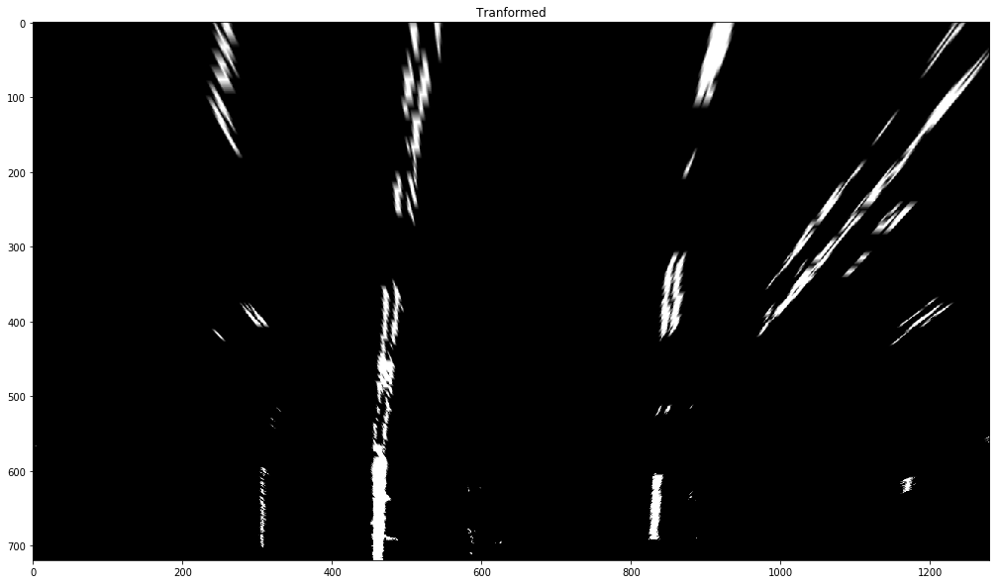

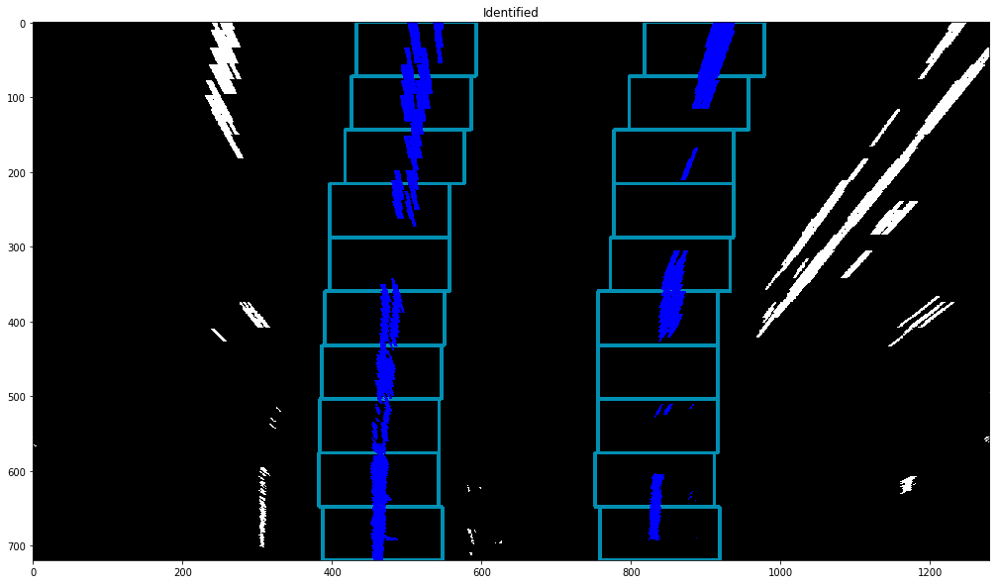

In [27]:
image = mpimg.imread(default_test_image)
image_undistorted = undistort(image)   
image_thresholded = get_thresholded_image(image_undistorted)  
image_perspective_transformed,_,transform_inv,_,_ = apply_pespective_transform(image_thresholded)
y_vals, left_x_vals, right_x_vals, left_fit, right_fit, lane_lines_img, vis_img = find_lane(image_perspective_transformed)
    
plt.figure();
plt.imshow(image_perspective_transformed);
plt.title('Tranformed');
    
plt.figure();
plt.imshow(vis_img);
plt.title('Identified');

### Step 6. Warp the detected lane boundaries back onto the original image.

To warp detected lane lines on the original image I use inverse transformation matrix which is returned from "apply_pespective_transform" function.

In [28]:
def draw_lane(img, lane_lines_img, y_vals, left_x_vals, right_x_vals, Minv):
    # Prepare the x/y points for cv2.fillPoly()
    left_points = np.array([np.vstack([left_x_vals, y_vals]).T])
    right_points = np.array([np.flipud(np.vstack([right_x_vals, y_vals]).T)])
    
    points = np.hstack((left_points, right_points))

    # Color the area between the lines (the lane)
    lane = np.zeros_like(lane_lines_img)  # Create a blank canvas to draw the lane on
    cv2.fillPoly(lane, np.int_([points]), (0, 255, 0))
    warped_lane_info = cv2.addWeighted(lane_lines_img, 1, lane, .3, 0)

    unwarped_lane_info = cv2.warpPerspective(warped_lane_info, Minv, (img.shape[1], img.shape[0]))
    drawn_img = cv2.addWeighted(img, 1, unwarped_lane_info, 1, 0)
    
    return drawn_img

def show_warped_overlayed_comparsion(test_images_paths):
    for image_path in test_images_paths:
        image = mpimg.imread(image_path)    
        image_undistorted = undistort(image)   
        image_thresholded = get_thresholded_image(image_undistorted)  
        image_perspective_transformed,_,transform_inv,_,_ = apply_pespective_transform(image_thresholded)
        y_vals, left_x_vals, right_x_vals, left_fit, right_fit, lane_lines_img, vis_img = find_lane(image_perspective_transformed)

        image_overlayed = draw_lane(image, lane_lines_img, y_vals, left_x_vals, right_x_vals, transform_inv)

        plt.figure();
        plt.imshow(vis_img);
        plt.plot(left_x_vals, y_vals, color='yellow')
        plt.plot(right_x_vals, y_vals, color='yellow')
        plt.title("Transformed "+image_path);

        plt.figure();
        plt.imshow(image_overlayed);
        plt.title("Transformed "+image_path);

Now we can take a look on the result of detection in three sets of test images. 

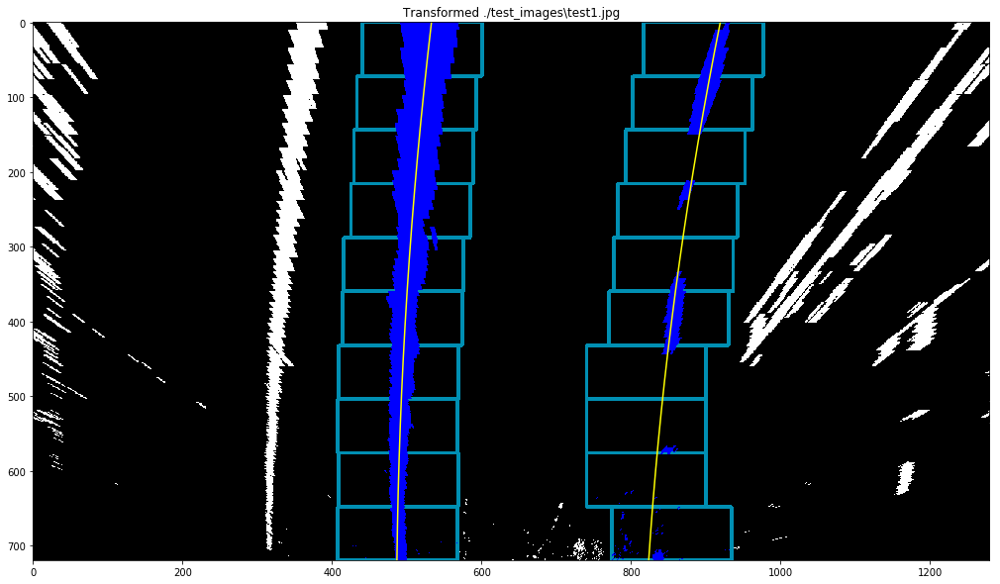

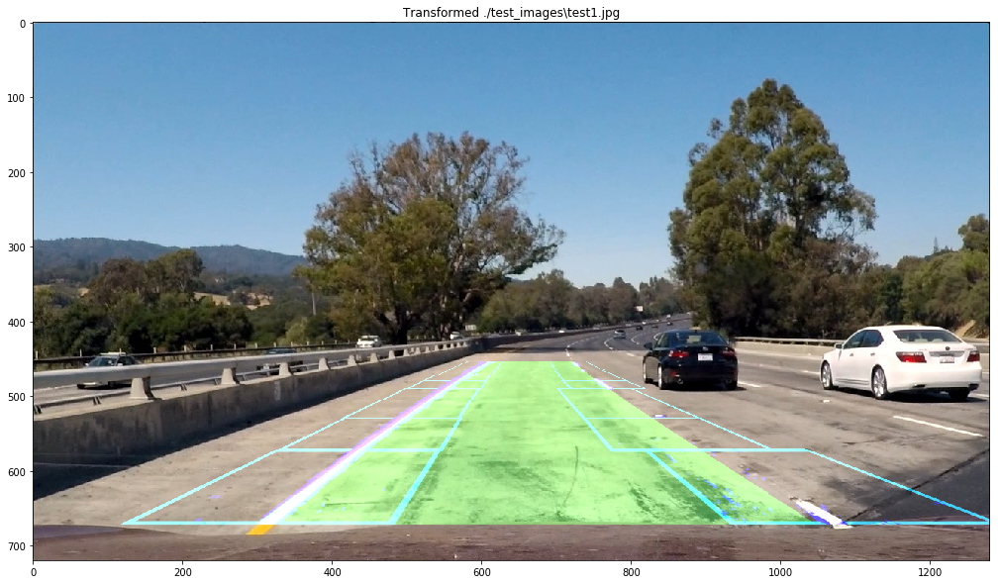

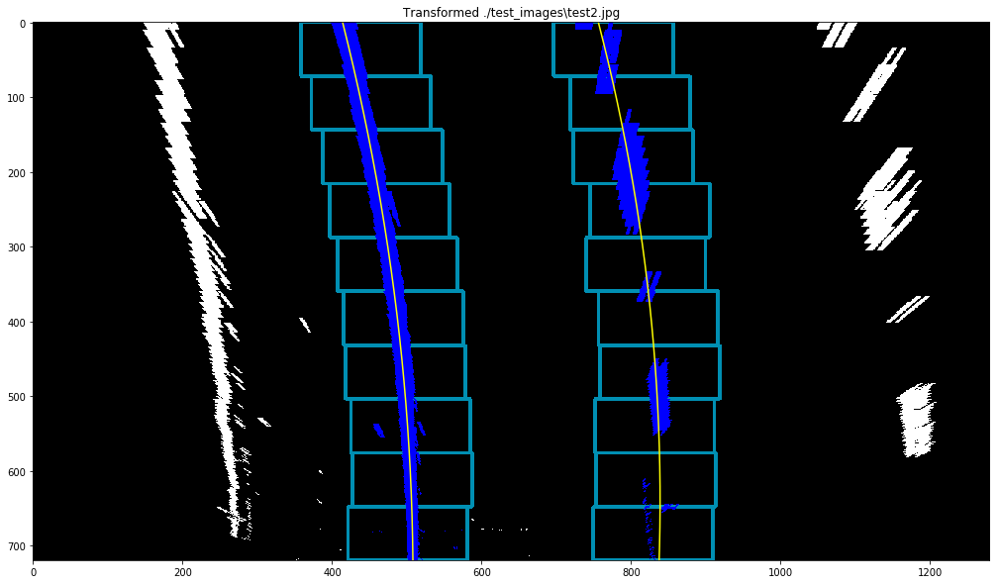

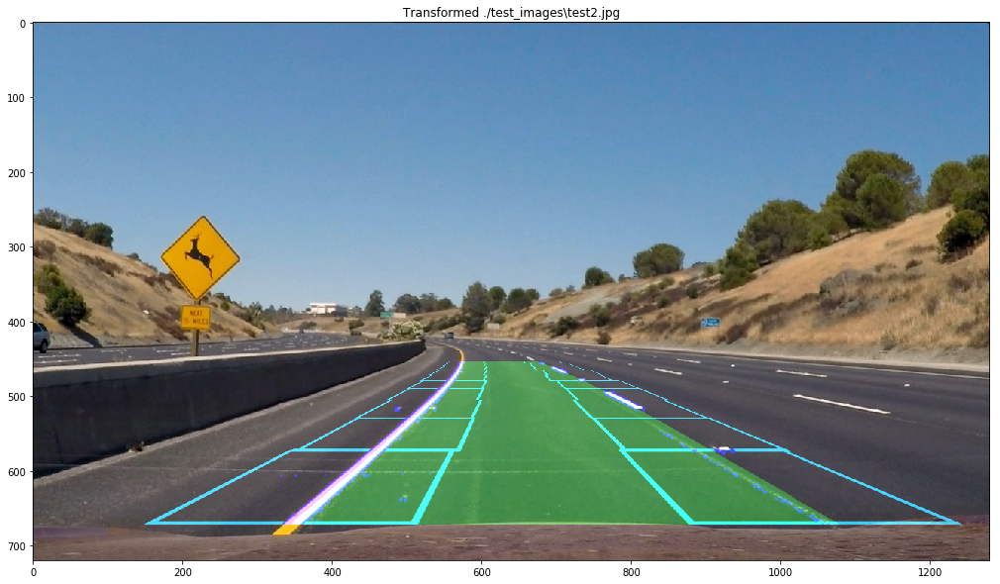

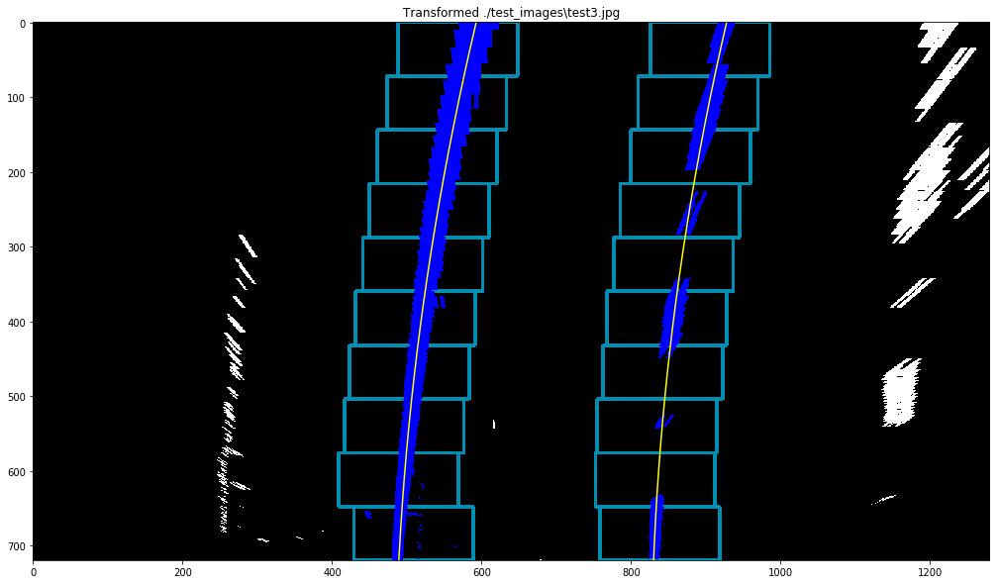

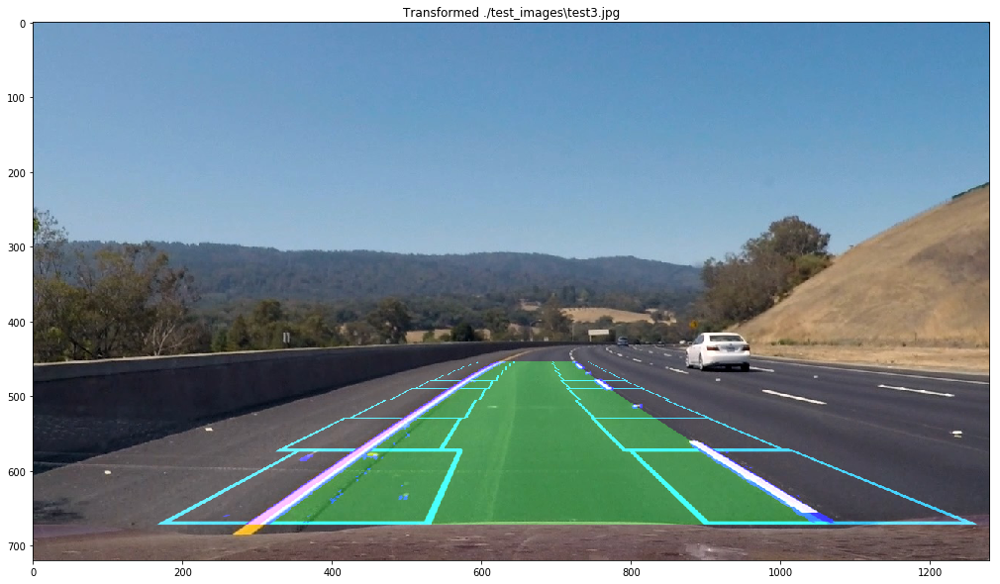

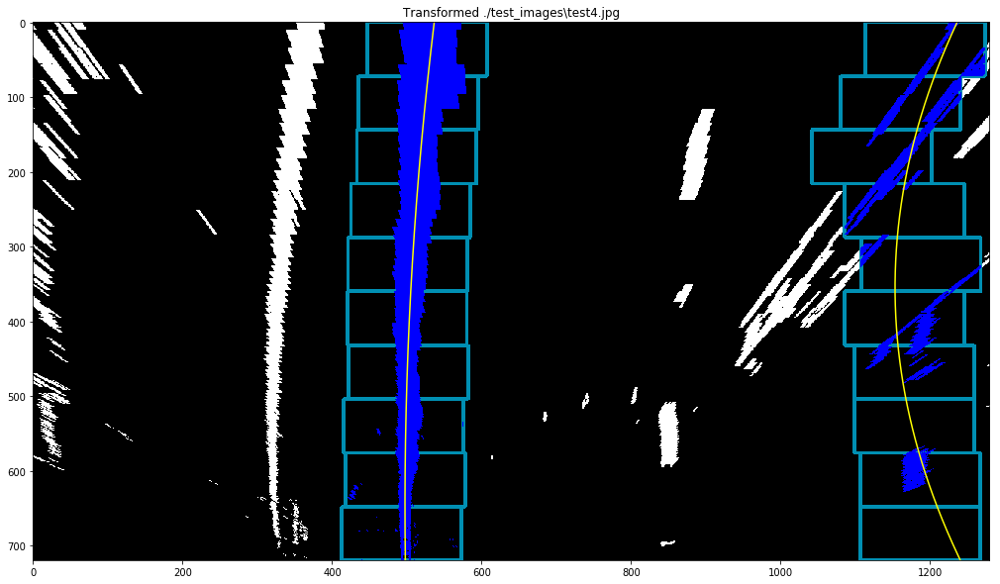

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


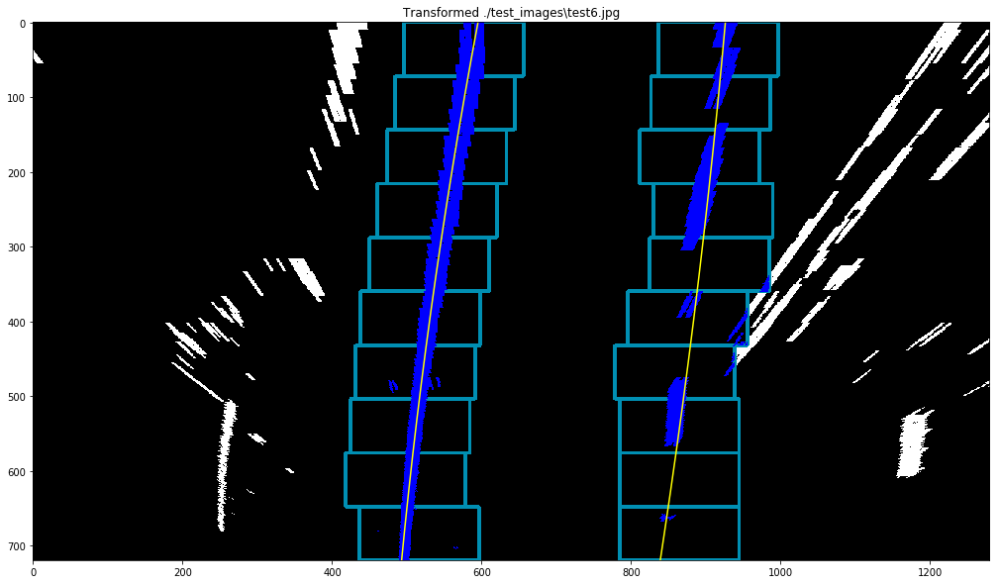

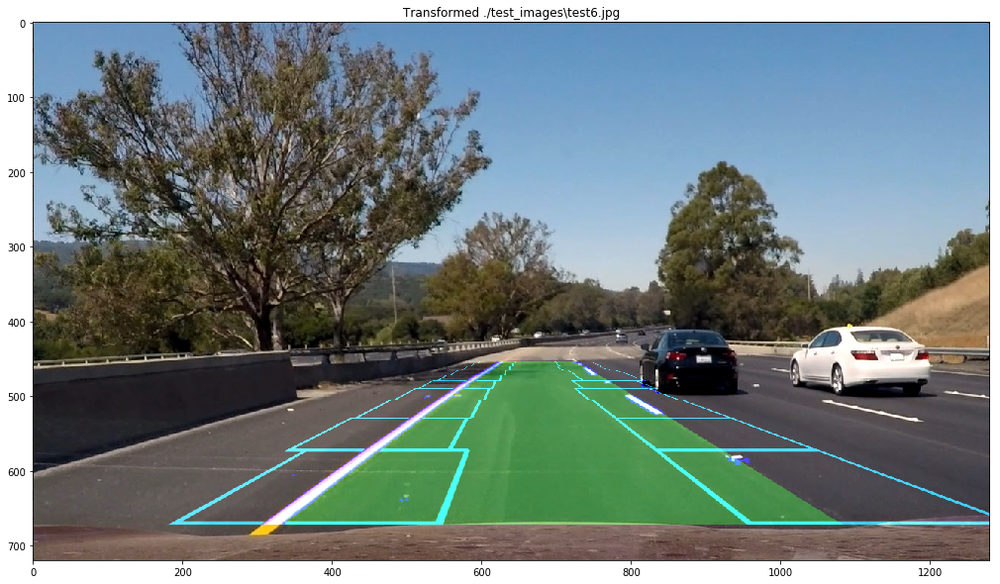

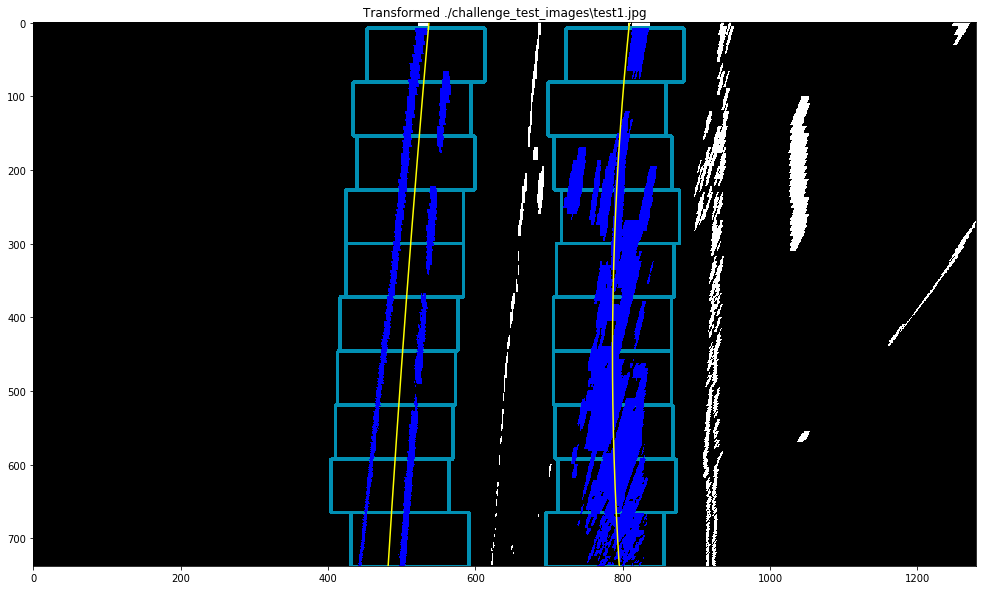

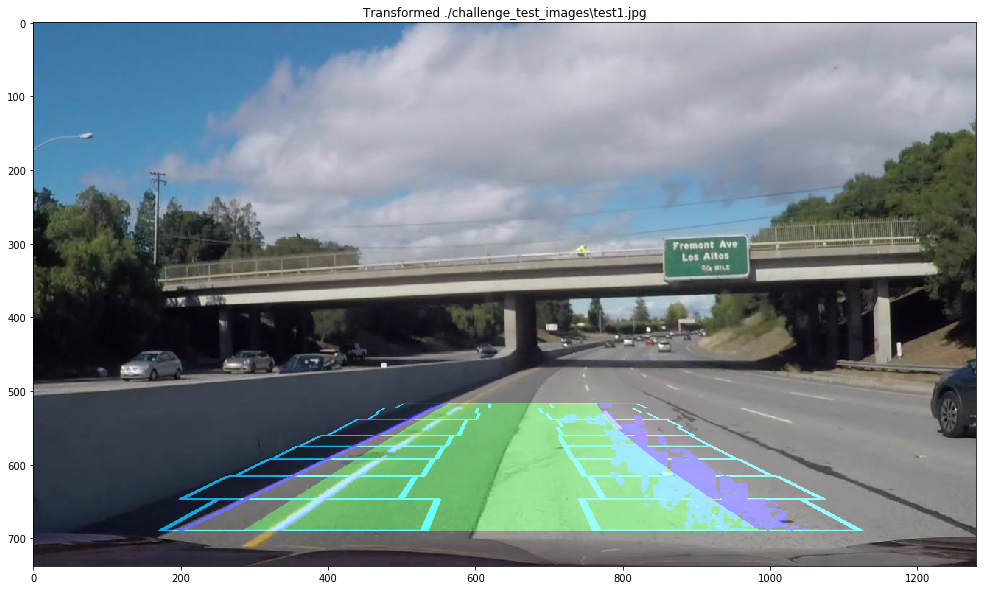

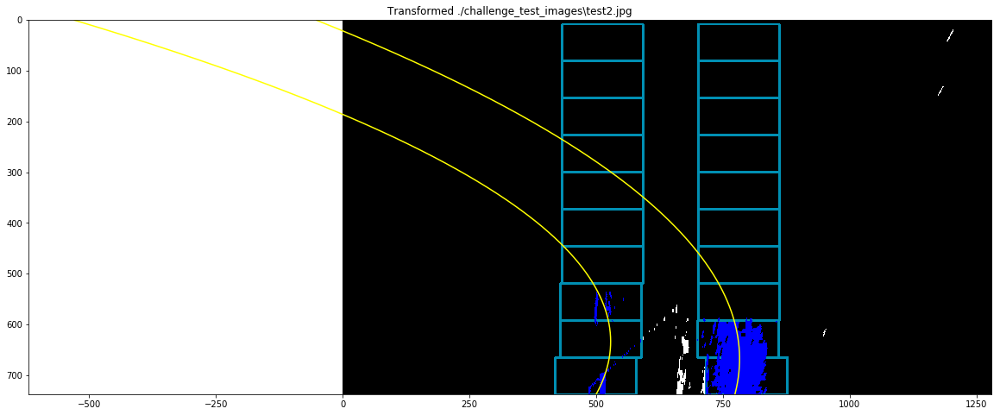

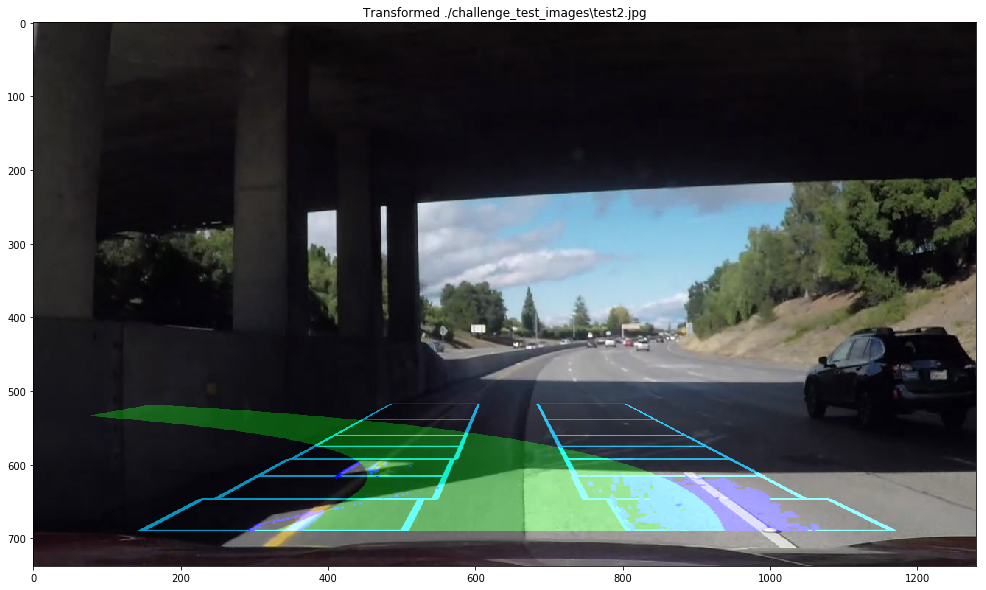

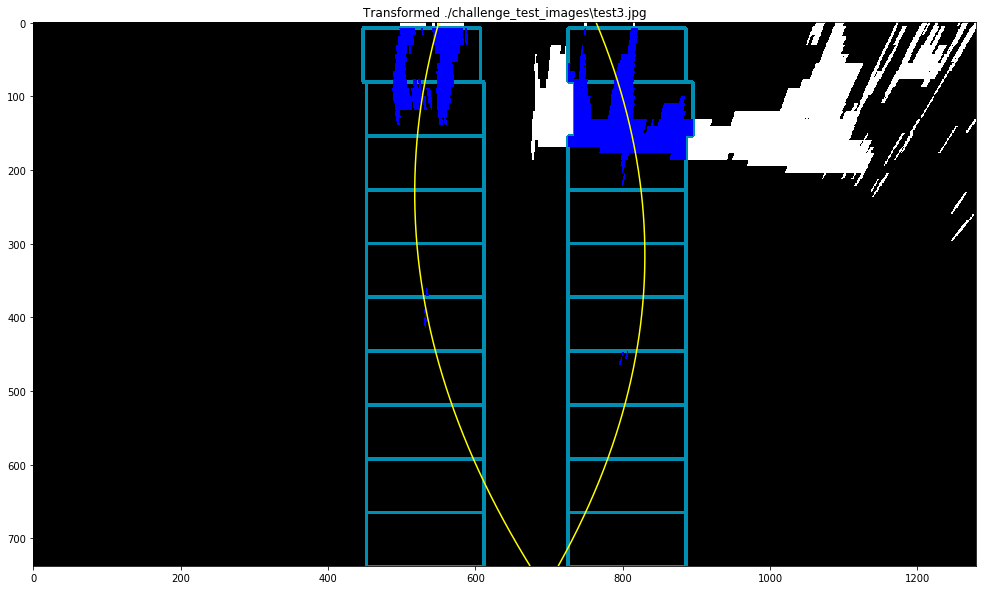

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


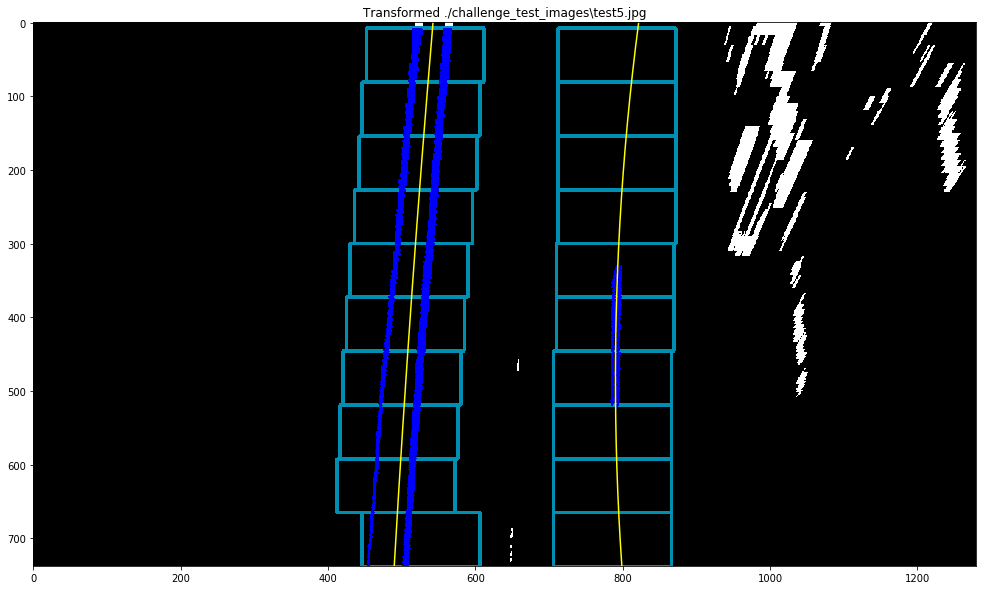

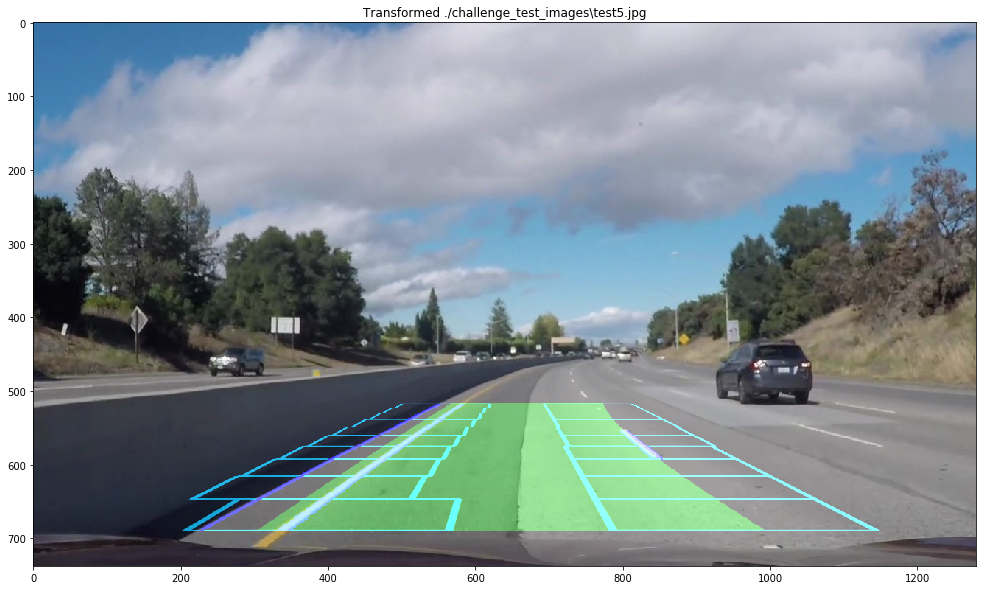

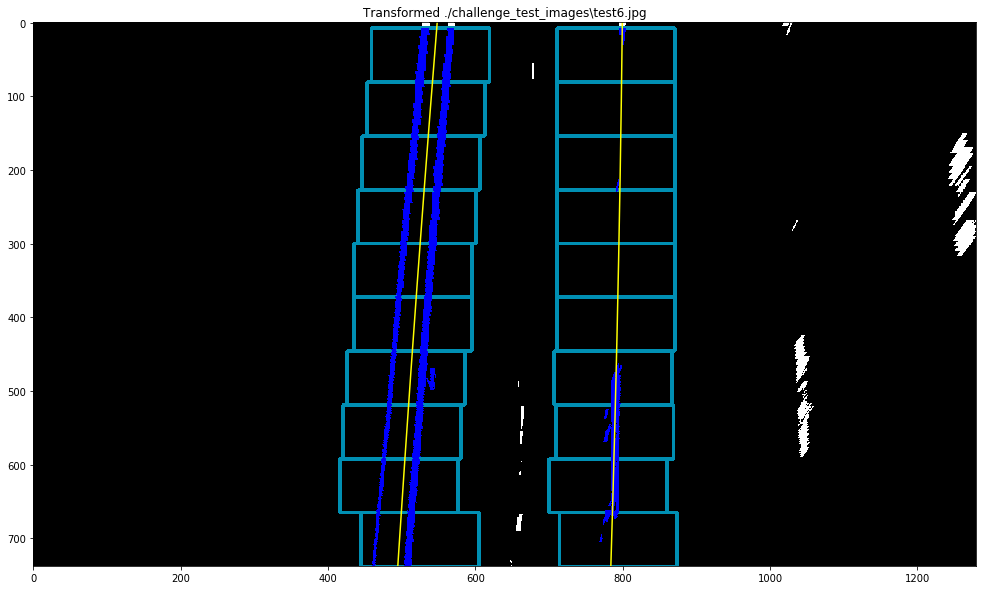

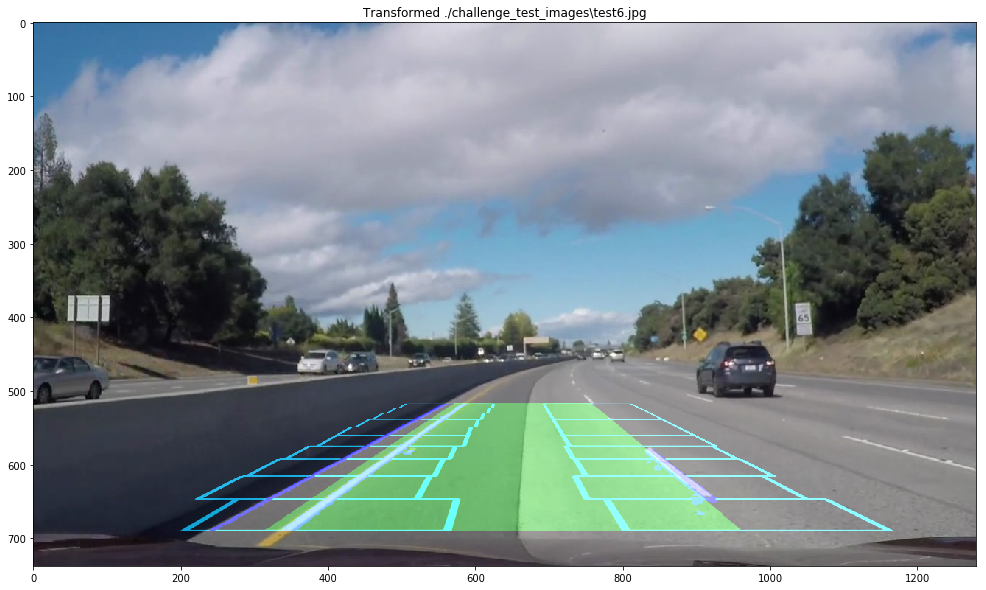

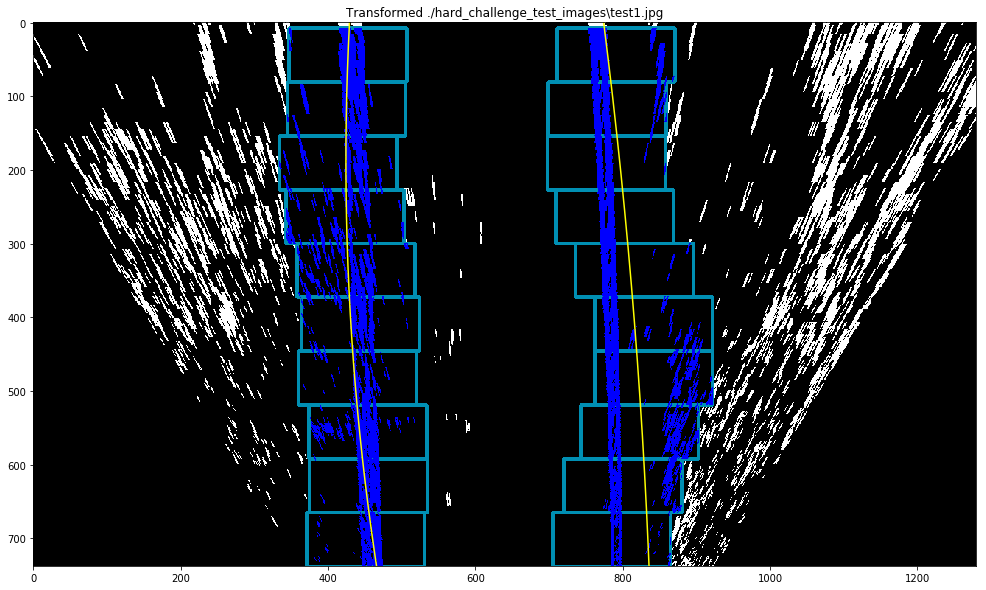

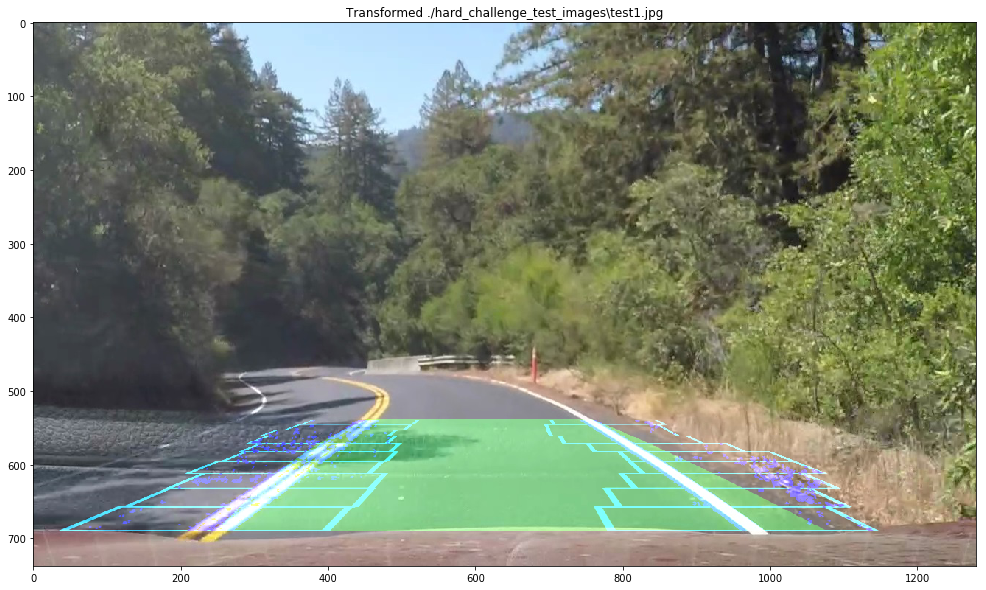

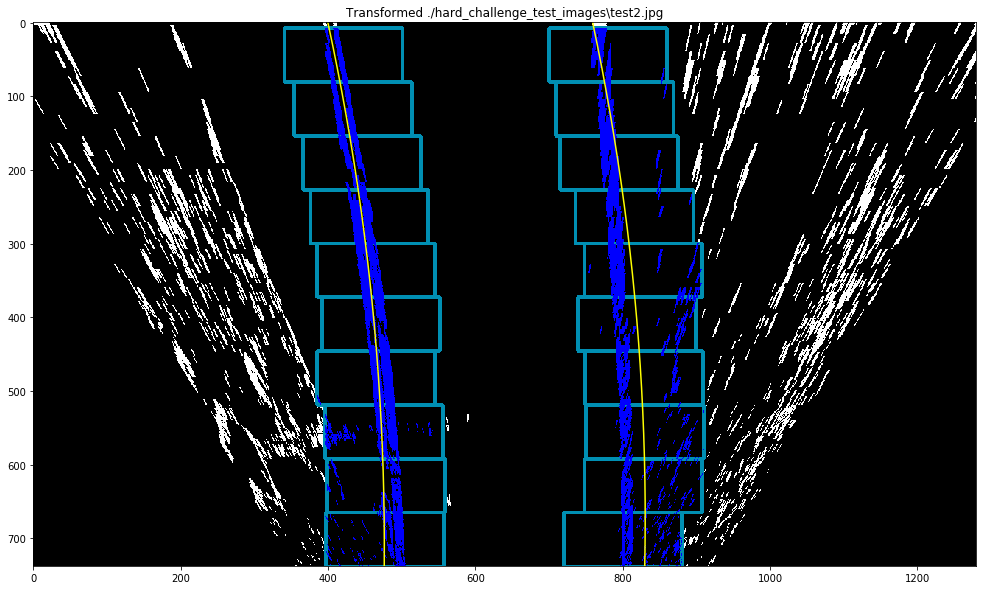

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


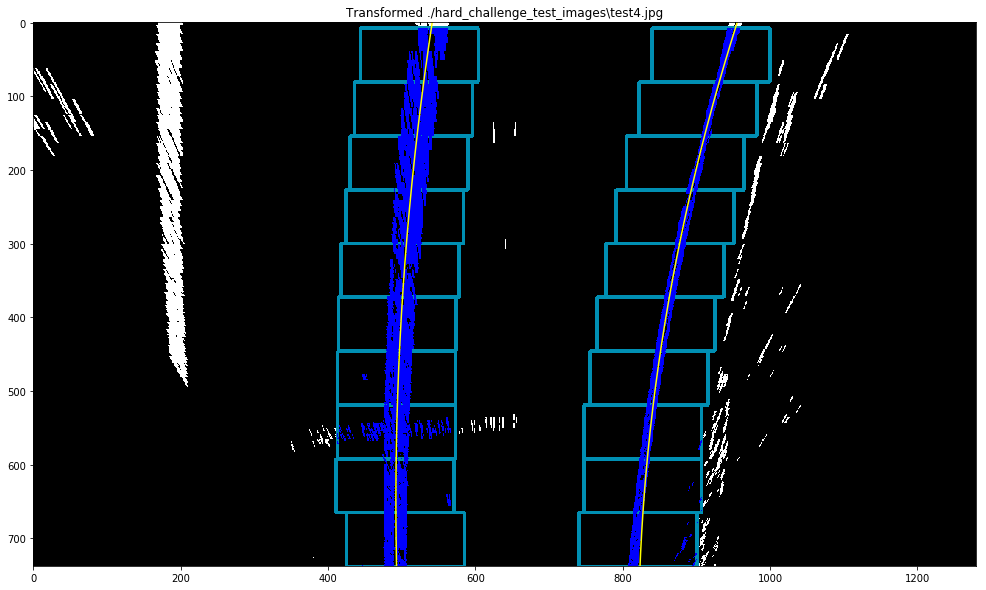

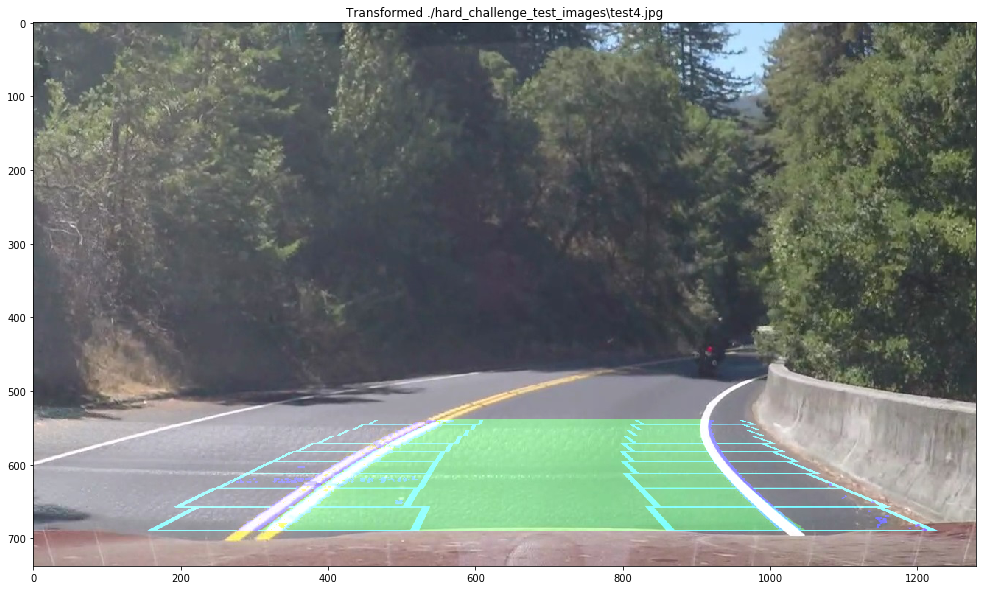

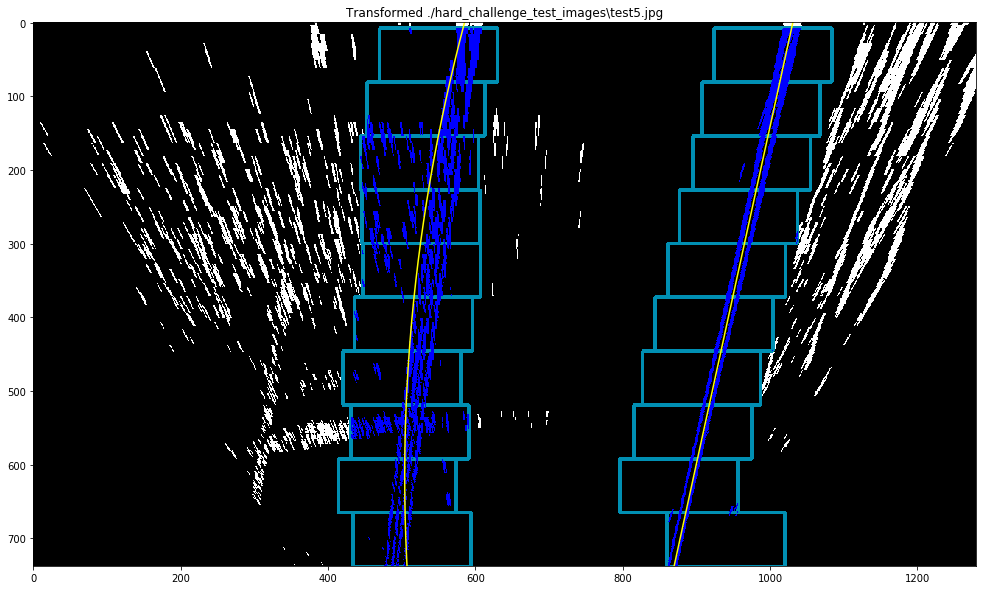

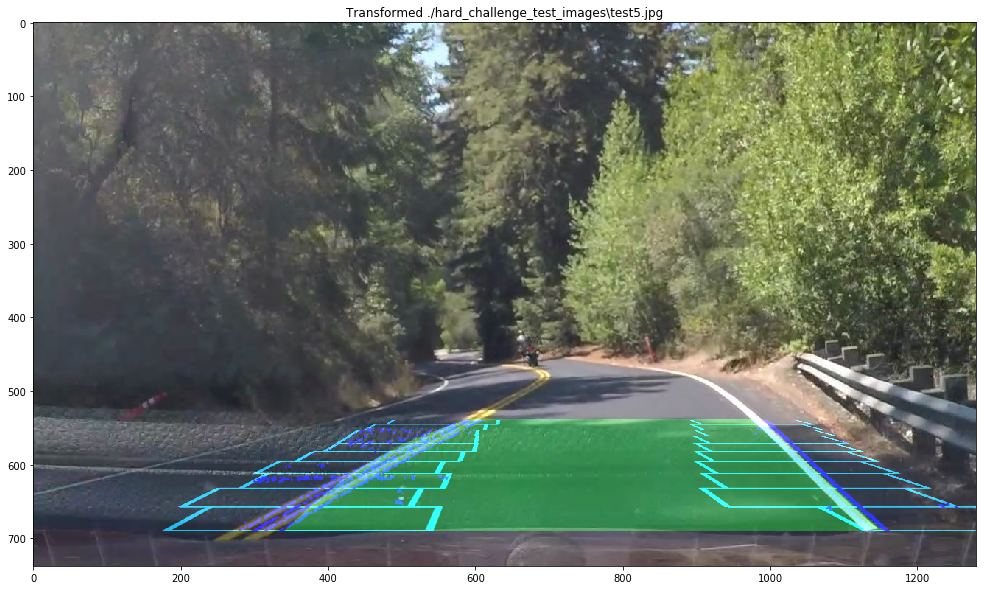

In [29]:
enable_default_options()

show_warped_overlayed_comparsion(test_images_paths)

enable_challenge_options()

show_warped_overlayed_comparsion(challenge_test_images_paths)
    
enable_hard_challenge_options()

show_warped_overlayed_comparsion(hard_test_images_paths)

enable_default_options() 

As it was expected, pipeline performed well on all of the test images except from ones which were captured under the bridge in "challenge video". 

### Step 7. Determine the curvature of the lane, vehicle position and apply smoothing effect

All of the major parts of the pipeline has been already done, except from curvature and vehicle position estimates. I addressed this task in the same way as in lectures and then pierced my pipeline together into set of functions.
The main function is detect_lane_pipe which takes an image and outputs an images with detected pipe, pipeline steps representations and curvature & vehicle position estimations. 
In order to perform a smooth processing of video files I average latest 3 detected lanes, which I store as objects of "Lane" class. I also compare every detected lane with previous detected lane to ensure that it did not change too much, because this will mean that the pipeline failed to detect lane on this frame.

In [30]:
class Lane():
    def __init__(self):
        self.y_vals = None
        self.left_x_vals = None
        self.right_x_vals = None
        self.lane_lines_img = None
        self.left_curvature = None
        self.right_curvature = None
        self.offset = None

def get_curvature(y_to_fit, x_to_fit, y_eval):
    # Conversion factors for pixels to meters
    m_per_pix_y, m_per_pix_x = 30/720, 3.7/700
    
    # Fit a new polynomial to world-space (in meters)
    fit = np.polyfit(y_to_fit*m_per_pix_y, x_to_fit*m_per_pix_x, 2)
    curvature = ((1 + (2*fit[0]*(y_eval*m_per_pix_y) + fit[1])**2)**1.5) / np.absolute(2*fit[0])
    
    return curvature

def calc_offset(left_x, right_x, img_center_x):
    lane_width = abs(left_x - right_x)
    lane_center_x = (left_x + right_x)//2
    pix_offset = img_center_x - lane_center_x
    
    lane_width_m = 3.7  # How wide we expect the lane to be in meters
    return lane_width_m * (pix_offset/lane_width)
        
        
# finds lane parametres in "birds-eye" image
def find_lane(image):
    global overlay_lane_color
    global overlay_lane_line_color
    
    # binary version of the image
    warped_bin = np.zeros_like(image[:,:,0])
    warped_bin[(image[:,:,0] > 0)] = 1
    
    # The image used for logging purposes
    vis_img = image.copy()  
    
    # Max out non-black pixels to remove them later
    vis_img[vis_img > 0] = 255  

    # get histogram
    histogram = get_histogram(warped_bin)

    # Find the left an right right peaks of the histogram
    midpoint = histogram.shape[0]//2
    
    # x-position for the left window
    left_x = np.argmax(histogram[:midpoint])  
    
    # x-position for the right window
    right_x = np.argmax(histogram[midpoint:]) + midpoint  

    n_windows = 10
    win_height = warped_bin.shape[0]//n_windows
    win_width = 80  
    
    # If we find this many pixels in our window we will recenter (too few would be a bad recenter)
    pix_threshold = win_width*2  

    # Find the non-zero x and y indices
    nonzero_ind = warped_bin.nonzero()
    nonzero_y_ind = np.array(nonzero_ind[0])
    nonzero_x_ind = np.array(nonzero_ind[1])

    left_line_ind, right_line_ind = [], []

    for win_i in range(n_windows):
        win_y_low = warped_bin.shape[0] - (win_i+1)*win_height
        win_y_high = warped_bin.shape[0] - (win_i)*win_height
        win_x_left_low = max(0, left_x - win_width)
        win_x_left_high = left_x + win_width
        win_x_right_low = right_x - win_width
        win_x_right_high = min(warped_bin.shape[1]-1, right_x + win_width)

        # Draw the windows on the vis_img
        rect_color, rect_thickness = overlay_lane_color, 3
        cv2.rectangle(vis_img, (win_x_left_low, win_y_high), (win_x_left_high, win_y_low), rect_color, rect_thickness)
        cv2.rectangle(vis_img, (win_x_right_low, win_y_high), (win_x_right_high, win_y_low), rect_color, rect_thickness)

        # Record the non-zero pixels within the windows
        left_ind = (
            (nonzero_y_ind >= win_y_low) &
            (nonzero_y_ind <= win_y_high) &
            (nonzero_x_ind >= win_x_left_low) &
            (nonzero_x_ind <= win_x_left_high)
        ).nonzero()[0]
        right_ind = (
            (nonzero_y_ind >= win_y_low) &
            (nonzero_y_ind <= win_y_high) &
            (nonzero_x_ind >= win_x_right_low) &
            (nonzero_x_ind <= win_x_right_high)
        ).nonzero()[0]
        
        left_line_ind.append(left_ind)
        right_line_ind.append(right_ind)

        # If there are enough pixels, re-align the window
        if len(left_ind) > pix_threshold:
            left_x = int(np.mean(nonzero_x_ind[left_ind]))
        if len(right_ind) > pix_threshold:
            right_x = int(np.mean(nonzero_x_ind[right_ind]))

    # Combine the arrays of line indices
    left_line_ind = np.concatenate(left_line_ind)
    right_line_ind = np.concatenate(right_line_ind)

    # Gather the final line pixel positions
    left_x = nonzero_x_ind[left_line_ind]
    left_y = nonzero_y_ind[left_line_ind]
    right_x = nonzero_x_ind[right_line_ind]
    right_y = nonzero_y_ind[right_line_ind]

    # Color the lines on the vis_img
    vis_img[left_y, left_x] = overlay_lane_line_color  # 254 so we can isolate the white 255 later
    vis_img[right_y, right_x] = overlay_lane_line_color  # 254 so we can isolate the white 255 later
    
    if(len(left_x) == 0 
       or len(left_y) == 0 
       or len(right_x) == 0 
       or len(right_y) == 0):
        return None
    
    # Fit a 2nd-order polynomial to the lines
    left_fit = np.polyfit(left_y, left_x, 2)
    right_fit = np.polyfit(right_y, right_x, 2)
    
    # Get our x/y vals for the fit lines
    y_vals = np.linspace(0, warped_bin.shape[0]-1, warped_bin.shape[0])
    left_x_vals = left_fit[0]*y_vals**2 + left_fit[1]*y_vals + left_fit[2]
    right_x_vals = right_fit[0]*y_vals**2 + right_fit[1]*y_vals + right_fit[2]
    
    # Calculate real-world curvature for each lane line
    left_curvature = get_curvature(left_y, left_x, np.max(y_vals))
    right_curvature = get_curvature(right_y, right_x, np.max(y_vals))
    
    # Calculate the center-lane offset of the car
    offset = calc_offset(left_x_vals[-1], right_x_vals[-1], image.shape[1]//2)

    lane_lines_img = vis_img.copy()
    lane_lines_img[lane_lines_img == 255] = 0  # This basically removes everything except the colored lane lines
    
    # Build the Lane object to return
    lane = Lane()
    lane.y_vals = y_vals
    lane.left_x_vals = left_x_vals
    lane.right_x_vals = right_x_vals
    lane.lane_lines_img = lane_lines_img
    lane.left_curvature = left_curvature
    lane.right_curvature = right_curvature
    lane.offset = offset
    
    return lane

# Compare lane to previously found lanes
def is_good_lane(lane):
    global prev_lanes
    
    if lane is None:
        return False
    
    # Measure the total x-pixel difference between the new and the old
    if len(prev_lanes) > 0:  
        
        prev_x_left = prev_lanes[0].left_x_vals
        prev_x_right = prev_lanes[0].right_x_vals
        
        current_x_left = lane.left_x_vals
        current_x_right = lane.right_x_vals

        left_diff = np.sum(np.absolute(prev_x_left - current_x_left))
        right_diff = np.sum(np.absolute(prev_x_right - current_x_right))

        lane_pixel_margin = 100  # How much different the new lane's x-values can be from the last lane
        diff_threshold = lane_pixel_margin*len(prev_x_left)

        if left_diff > diff_threshold or right_diff > diff_threshold:
            return False
    
    return True


# Average latest lanes to smooth the transition between frames
def average_lanes():
    global prev_lanes
    
    if len(prev_lanes) == 0: 
        return None
    elif len(prev_lanes) == 1: 
        return prev_lanes[0]
    else: 
        n_lanes = len(prev_lanes)
        new_lane = prev_lanes[0]
        
        avg_lane = Lane()  # The averaged lane we will return (with some defaults)
        avg_lane.y_vals = new_lane.y_vals
        avg_lane.lane_lines_img = new_lane.lane_lines_img

        # Average the left and right lanes' x-values
        left_avg = new_lane.left_x_vals
        right_avg = new_lane.right_x_vals
        for i in range(1, n_lanes):
            left_avg = np.add(left_avg, prev_lanes[i].left_x_vals)
            right_avg = np.add(right_avg, prev_lanes[i].right_x_vals)

        avg_lane.left_x_vals = left_avg / n_lanes
        avg_lane.right_x_vals = right_avg / n_lanes
        
        # Average the curvatures and offsets
        avg_lane.left_curvature = sum([lane.left_curvature for lane in prev_lanes])/n_lanes
        avg_lane.right_curvature = sum([lane.right_curvature for lane in prev_lanes])/n_lanes
        avg_lane.offset = sum([lane.offset for lane in prev_lanes])/n_lanes

        return avg_lane


def detect_lane_pipe(image):
    global prev_lanes
    global bad_lanes_num
    global overlay_lane_line_color
    
    if type(image) is str: 
        image = mpimg.imread(image)
        
    lanes_storage_num = 3
        
    image_undistorted = undistort(image)   
    image_thresholded = get_thresholded_image(image_undistorted)  
    
    image_perspective_transformed,_,transform_inv, src_pts, dst_pts = apply_pespective_transform(image_thresholded)
    
    lane = find_lane(image_perspective_transformed)
    
    if is_good_lane(lane):  
        bad_lanes_num = 0
        prev_lanes.insert(0, lane)
        if len(prev_lanes) > lanes_storage_num: prev_lanes.pop()
    else:
        bad_lanes_num += 1
        
    # clear lanes if there are too many of bad lanes.
    if bad_lanes_num >= lanes_storage_num:
        bad_lanes_num = 0
        prev_lanes = []
        
    # skip drawing if nothing to show
    if len(prev_lanes) > 0: 
        image_overlayed = get_image_overlayed(image, average_lanes(), transform_inv)
    else:
        image_overlayed = image
            
    image_debug_transformation = image_thresholded.copy()
    for i in range(4):
        image_debug_transformation = cv2.line(image_debug_transformation, 
                                              (int(src_pts[i][0]), int(src_pts[i][1])), 
                                              (int(src_pts[(i+1)%4][0]), int(src_pts[(i+1)%4][1])), 
                                              color=overlay_lane_line_color, 
                                              thickness=4)    
        
    return create_output_frame(image_overlayed, lane, image_thresholded, image_debug_transformation, image_perspective_transformed)

def get_image_overlayed(img, lane, transform_inv):
    
    if lane is None:
        return img
    
    # Prepare the x/y points for cv2.fillPoly()
    left_points = np.array([np.vstack([lane.left_x_vals, lane.y_vals]).T])
    right_points = np.array([np.flipud(np.vstack([lane.right_x_vals, lane.y_vals]).T)])
    
    points = np.hstack((left_points, right_points))

    # Color the area between the lines (the lane)
    filled_lane = np.zeros_like(lane.lane_lines_img)  # Create a blank canvas to draw the lane on
    cv2.fillPoly(filled_lane, np.int_([points]), (0, 255, 0))
    
    warped_lane_info = cv2.addWeighted(lane.lane_lines_img, 1, filled_lane, .3, 0)

    unwarped_lane_info = cv2.warpPerspective(warped_lane_info, transform_inv, (img.shape[1], img.shape[0]))
    
    final_frame = cv2.addWeighted(img, 1, unwarped_lane_info, 1, 0)
        
    return final_frame

## Step 8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

There is only one step left: to use the pipeline on the test videos. The last function in this pipeline builds an output frame which contains frame with visible detected lane and it's boundaries, images of thresholding, trapezoid, birds-eye view and lane detection in warped state. It also outputs lane curvature and vehicle offset.

In [31]:
def create_output_frame(frame_overlayed, lane, image_thresholded, image_debug_transformation, birds_eye_transformed):
    global prev_lanes
    global overlay_text_color
    
    img_out = np.zeros((840, 2240, 3), dtype = np.uint8)
    
    img_out[0:720, 0:1280,     :] = cv2.resize(frame_overlayed, (1280, 720))
    
    img_out[0:360, 1280:1760, :]    = cv2.resize(image_thresholded, (480, 360))
    img_out[360:720, 1280:1760, :]    = cv2.resize(image_debug_transformation, (480, 360)) 
    
    img_out[0:360, 1760:2240, :]    = cv2.resize(birds_eye_transformed, (480, 360))
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    scale = .7
    color =  overlay_text_color
    line_type = cv2.LINE_AA
    
    if lane is not None:
        img_out[360:720, 1760:2240, :]    = cv2.resize(lane.lane_lines_img, (480, 360)) 
        
        cv2.putText(
            img_out,
            'Left Curvature: {:.2f}m       Right Curvature: {:.2f}m'.format(lane.left_curvature, lane.right_curvature),
            (20, 760),  # origin point
            font,
            scale,
            color,
            lineType=line_type
        )
        cv2.putText(
            img_out,
            'Center-Lane Offset: {:.2f}m'.format(lane.offset),
            (20, 800),  # origin point
            font,
            scale,
            color,
            lineType=line_type
        )
    else:
        cv2.putText(
            img_out,
            'Could not detect a lane',
            (20, 800),  # origin point
            font,
            scale,
            color,
            lineType=line_type
        )
    
    return img_out

Before using the pipeline on videos let's take a little sanity check that everything is working correctly by applying the pipeline on a single test image.

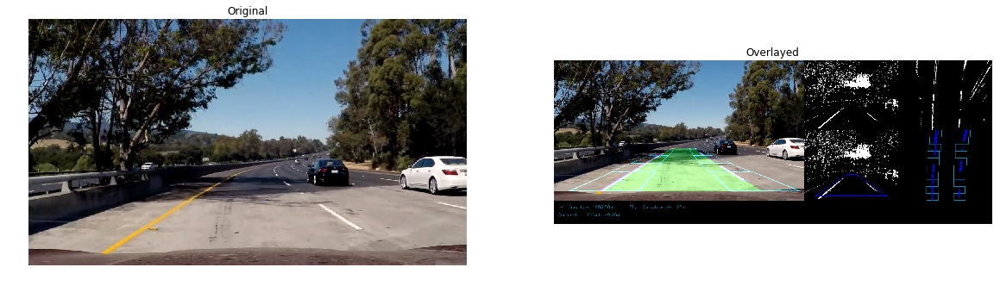

In [32]:
enable_default_options() 

bad_lanes_num = 0
prev_lanes = []

image = mpimg.imread(default_test_image)

overlay_img = detect_lane_pipe(image)

show_images_comparsion_row([image, overlay_img], ["Original", "Overlayed"])

It seems like everything is alright, so we can finally see the results on the test videos! To process videos and show them in the editor I use the same functions as in the first project of this nanodegree.

In [39]:
def process_video(video_name):
    bad_lanes_num = 0
    prev_lines = []

    video = VideoFileClip("./test_videos/"+video_name) 
    video = video.fl_image(detect_lane_pipe) 
    %time video.write_videofile("./videos_out/"+video_name, audio=False)  

In [34]:
enable_default_options()

process_video("project_video.mp4")

[MoviePy] >>>> Building video ./videos_out/project_video.mp4
[MoviePy] Writing video ./videos_out/project_video.mp4


100%|█████████████████████████████████████▉| 1260/1261 [03:35<00:00,  6.17it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./videos_out/project_video.mp4 

Wall time: 3min 36s


In [35]:
enable_challenge_options()

process_video("challenge_video.mp4")

[MoviePy] >>>> Building video ./videos_out/challenge_video.mp4
[MoviePy] Writing video ./videos_out/challenge_video.mp4


100%|████████████████████████████████████████| 485/485 [01:22<00:00,  5.73it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./videos_out/challenge_video.mp4 

Wall time: 1min 24s


In [36]:
enable_hard_challenge_options()

process_video("harder_challenge_video.mp4")

[MoviePy] >>>> Building video ./videos_out/harder_challenge_video.mp4
[MoviePy] Writing video ./videos_out/harder_challenge_video.mp4


100%|█████████████████████████████████████▉| 1199/1200 [04:31<00:00,  4.11it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./videos_out/harder_challenge_video.mp4 

Wall time: 4min 34s


In [41]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format("./videos_out/project_video.mp4"))

In [42]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format("./videos_out/challenge_video.mp4"))

In [43]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format("./videos_out/harder_challenge_video.mp4"))